<div style="background-color: brown; padding: 10px; color: black;">

Course [IT790A] Explainable AI

Name: Abed Bakkour

Username: a22abeal
</div>

## Contents

- [Setup](#Setup-and-overview)

- [Data cleaning](#Data-cleaning)

    - [Categorical variables](#Categorical-variables)

    - [Numerical variables](#Numerical-variables)

- [Grid search and modeling](#Grid-search-and-modeling)

- [Train](#Train-with-best-parameters)

- [Predict](#Predict)

- [Explain model with LIME](#Explain-model-with-LIME)

- [Local explanation](#LIME-Local-explanation-(one-day))

- [Questions and Answers](#Questions-and-answers)

In [1]:
import pandas as pd
import numpy as np
np.random.seed(0)
import matplotlib.pyplot as plt
import seaborn as sb
import plotly.express as px

from sklearn.preprocessing import OneHotEncoder, StandardScaler, LabelEncoder
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error, mean_absolute_error
from sklearn import preprocessing
from sklearn.model_selection import train_test_split, GridSearchCV
import xgboost as xgb

np.random.seed(0)

import lime
import shap
from lime.lime_tabular import LimeTabularExplainer
import time

Using `tqdm.autonotebook.tqdm` in notebook mode. Use `tqdm.tqdm` instead to force console mode (e.g. in jupyter console)


# Setup and overview 

[For detailed information](https://archive.ics.uci.edu/ml/datasets/bike+sharing+dataset)

In [2]:
df = pd.read_csv('../data/day-bikesharing.csv',parse_dates=['dteday'],index_col=1) # Load the data

In [3]:
df.shape

(731, 15)

In [4]:
def add_features(df):
    df['year'] = df.index.year # yr exists already
    df['month'] = df.index.month
    df['day'] = df.index.day
    df['dayofweek'] = df.index.dayofweek

2011.Jan.1 is a Saturday.

In [5]:
add_features(df)
df.head(3)

,instant,season,yr,mnth,holiday,weekday,workingday,weathersit,temp,atemp,hum,windspeed,casual,registered,cnt,year,month,day,dayofweek
dteday,,,,,,,,,,,,,,,,,,,
2011-01-01,1,1,0,1,0,6,0,2,0.344167,0.363625,0.805833,0.160446,331,654,985,2011,1,1,5
2011-01-02,2,1,0,1,0,0,0,2,0.363478,0.353739,0.696087,0.248539,131,670,801,2011,1,2,6
2011-01-03,3,1,0,1,0,1,1,1,0.196364,0.189405,0.437273,0.248309,120,1229,1349,2011,1,3,0


## Notice: We select meaningful variables for a better understanding of the SHAP results. 

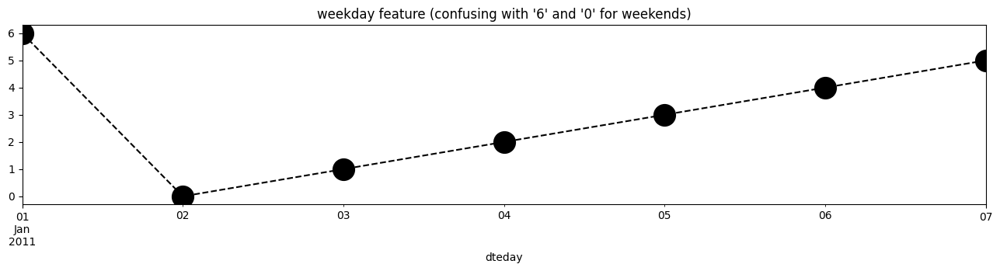

In [6]:
# Let's use 'dayofweek' instead of 'weekday'.
plt.figure(figsize=(16,3))
df['weekday'][:7].plot(linestyle='--', marker='o', color='k', ms=20, 
                       title='weekday feature (confusing with \'6\' and \'0\' for weekends)')
plt.show()

## We will use 'dayofweek' variable when describing each day of a week. Weekends of Saturday and Sunday are 5 and 6. The other weekdays are 0 to 4.

- When analyzing with SHAP, we consider higher numbers of 'dayofweek' feature to show the weekends.

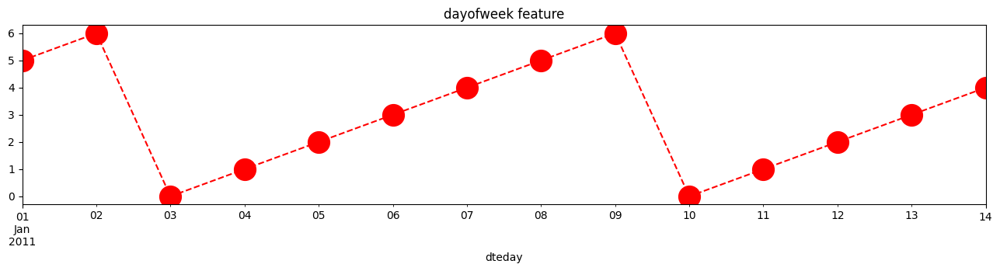

In [7]:
plt.figure(figsize=(16,3))
df['dayofweek'][:14].plot(linestyle='--', marker='o', color='r', ms=20, 
                       title='dayofweek feature')
plt.show()

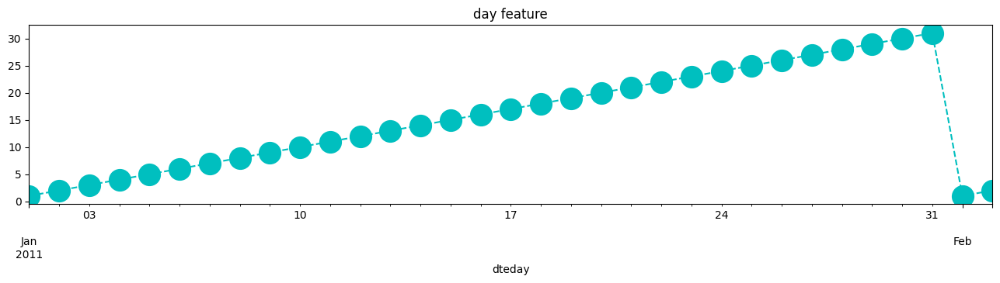

In [8]:
# Day feature shows whether it is a start of the month or the end of the month (1 to 30 or 31).
plt.figure(figsize=(16,3))
df['day'][:33].plot(linestyle='--', marker='o', color='c', ms=20, title='day feature')
plt.show()

## Workingday feature is a boolean. 

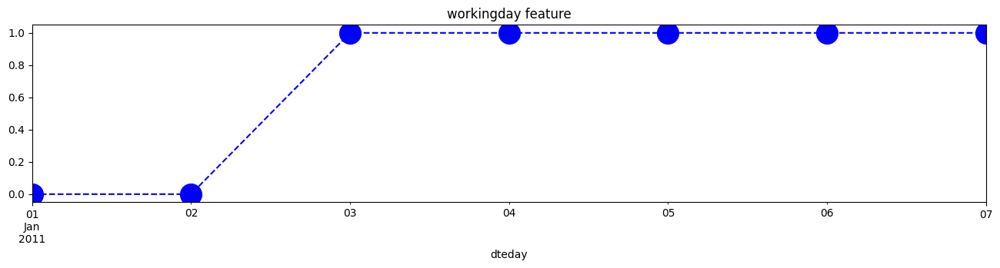

In [9]:
plt.figure(figsize=(16,3))
df['workingday'][:7].plot(linestyle='--', marker='o', color='b', ms=20, title='workingday feature')
plt.show()

## Note that season 1 indicates winter.

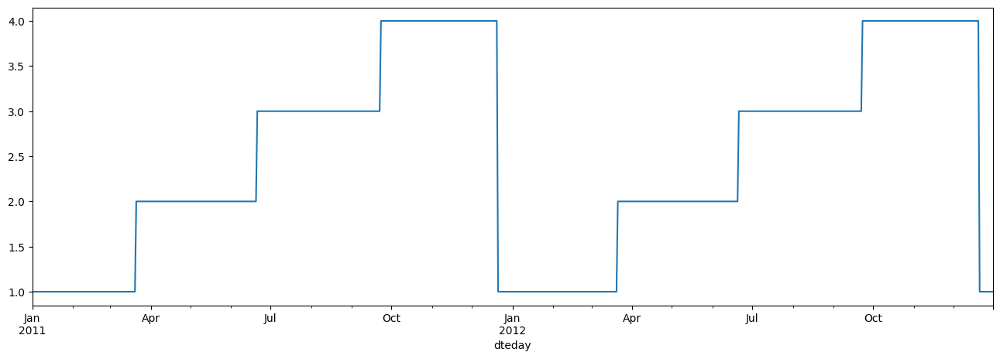

In [10]:
plt.figure(figsize=(16,5))
df['season'].plot()
plt.show()

In [11]:
df.season.value_counts()

3    188
2    184
1    181
4    178
Name: season, dtype: int64

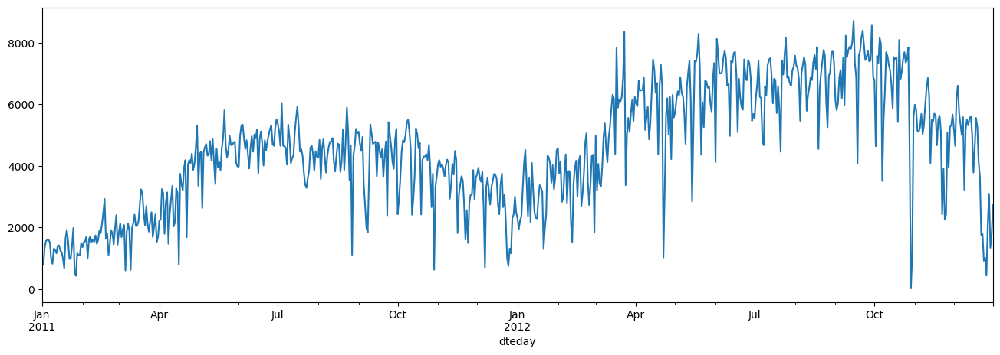

In [12]:
plt.figure(figsize=(16,5))
df['cnt'].plot()
plt.show()

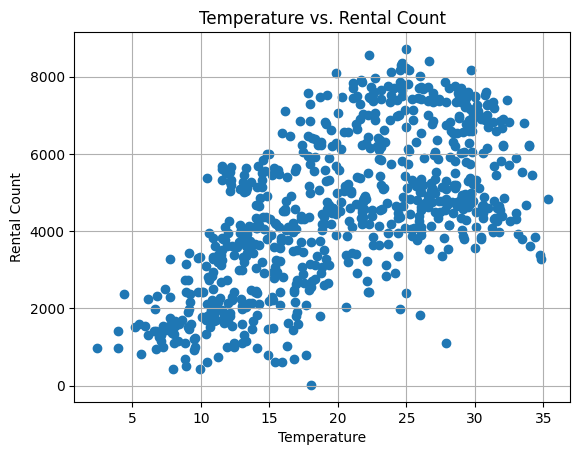

In [13]:
plt.scatter(x=df.temp*41,y=df["cnt"]) # denormalize temperature by multiplying 41
plt.grid(True)
plt.xlabel('Temperature')
plt.ylabel('Rental Count')
plt.title('Temperature vs. Rental Count')
plt.show()

Text(0.5, 1.0, 'Average Rental Count by Month')

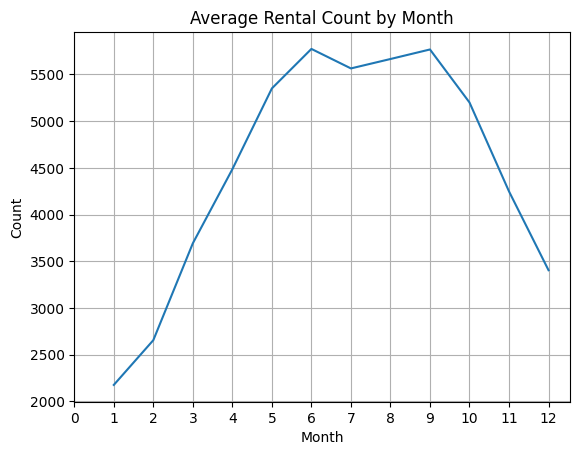

In [14]:
# from January to April, the demand is relatively low due to Winter 
#(there are not a lot of people that's brave enough to bike on icy road, are there?). 
# And the peak demand happends around Summer time (from May to October) and drop again.
group_month = df.groupby(['month'])
average_by_month = group_month['cnt'].mean()

plt.plot(average_by_month.index,average_by_month)
plt.xlabel('Month')
plt.ylabel('Count')
plt.xticks(np.arange(13))
plt.grid(True)
plt.title('Average Rental Count by Month')

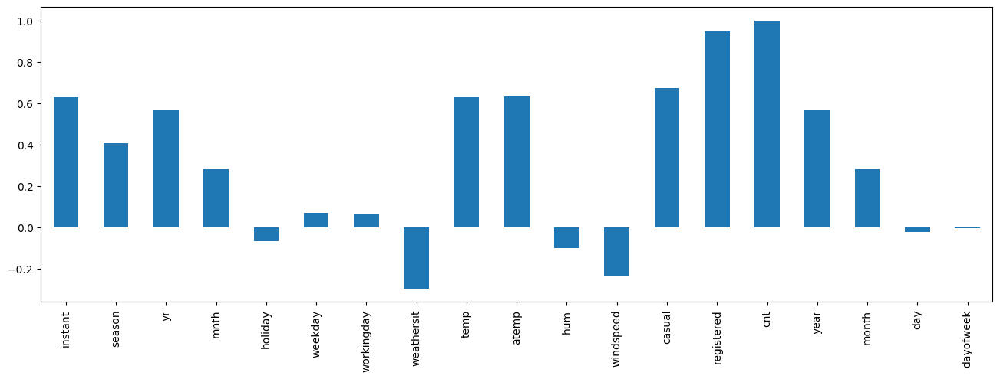

In [15]:
#correlation of total cnt with other variables
plt.figure(figsize=(16,5))
df.corr()['cnt'].plot(kind='bar')
plt.show()

In [16]:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
instant,731.0,366.000000,211.165812,1.000000,183.500000,366.000000,548.500000,731.000000
season,731.0,2.496580,1.110807,1.000000,2.000000,3.000000,3.000000,4.000000
yr,731.0,0.500684,0.500342,0.000000,0.000000,1.000000,1.000000,1.000000
mnth,731.0,6.519836,3.451913,1.000000,4.000000,7.000000,10.000000,12.000000
holiday,731.0,0.028728,0.167155,0.000000,0.000000,0.000000,0.000000,1.000000
weekday,731.0,2.997264,2.004787,0.000000,1.000000,3.000000,5.000000,6.000000
workingday,731.0,0.683995,0.465233,0.000000,0.000000,1.000000,1.000000,1.000000
weathersit,731.0,1.395349,0.544894,1.000000,1.000000,1.000000,2.000000,3.000000
temp,731.0,0.495385,0.183051,0.059130,0.337083,0.498333,0.655417,0.861667
atemp,731.0,0.474354,0.162961,0.079070,0.337842,0.486733,0.608602,0.840896


In [17]:
df.dtypes

instant         int64
season          int64
yr              int64
mnth            int64
holiday         int64
weekday         int64
workingday      int64
weathersit      int64
temp          float64
atemp         float64
hum           float64
windspeed     float64
casual          int64
registered      int64
cnt             int64
year            int64
month           int64
day             int64
dayofweek       int64
dtype: object

# Data cleaning

# Categorical variables

Perform one hot encoding on categorical variables. Machine learning algorithms assume (and require) the data to be numeric, so the categorical data must be pre-processed as a numerical data.  Categorical variables turn into binary features that are 'one hot' encoded, so if a feature is represented by that column, it receives a 1, otherwise a 0.

- The 'season' feature has 1: winter, 2: spring, 3: summer, 4: fall. 
- The 'holiday' and 'workingday' features are boolean: 1 when it is a holiday. 1 when it is a working day.

In [18]:
# Define the categorical variables
cat_var = ['season', 'holiday', 'workingday', 'weathersit', 'year']

In [19]:
# OneHotEncoder
ohe = OneHotEncoder(categories = 'auto')

In [20]:
# Fit the categorical variables to the encoder
encodeddf = ohe.fit_transform(df[cat_var])

In [21]:
# Create a DataFrame with the encoded value information
cat_df = pd.DataFrame(data = encodeddf.toarray(), columns = ohe.get_feature_names_out(cat_var))
cat_df

,season_1,season_2,season_3,season_4,holiday_0,holiday_1,workingday_0,workingday_1,weathersit_1,weathersit_2,weathersit_3,year_2011,year_2012
0,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0
1,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0
2,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,0.0
3,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,0.0
4,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...
726,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0
727,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0
728,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0
729,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,1.0


In [22]:
# rename the column names from 1,2,3,4 to spring, summer, fall, winter
cat_df.rename(columns={'season_1': 'winter', 'season_2': 'spring', 'season_3': 'summer', 'season_4': 'fall'}, inplace=True)
cat_df.rename(columns={'weathersit_1': 'clear', 'weathersit_2': 'cloudy', 'weathersit_3': 'lightsnow.rain'}, inplace=True)
cat_df

,winter,spring,summer,fall,holiday_0,holiday_1,workingday_0,workingday_1,clear,cloudy,lightsnow.rain,year_2011,year_2012
0,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0
1,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0
2,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,0.0
3,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,0.0
4,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...
726,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0
727,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0
728,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0
729,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,1.0


# Numerical variables

Machine learning is sensitive to the relative scales of numerical variables. The range of all variables need to be normalized so that each feature contributes approximately proportionately to the calculation.

In [23]:
# Define the numerical variables
num_var = ['temp', 'atemp', 'hum', 'windspeed', 'month', 'day', 'dayofweek']       

Create standardized, normalized

In [24]:
# StandardScaler object
scaler = StandardScaler()

In [25]:
# Fit the data to the scaler
numscaled = scaler.fit_transform(df[num_var])

Keep the original for later view

In [26]:
# for inverse transformation
inversed = scaler.inverse_transform(numscaled)
print(inversed)

[[ 0.344167  0.363625  0.805833 ...  1.        1.        5.      ]
 [ 0.363478  0.353739  0.696087 ...  1.        2.        6.      ]
 [ 0.196364  0.189405  0.437273 ...  1.        3.        0.      ]
 ...
 [ 0.253333  0.2424    0.752917 ... 12.       29.        5.      ]
 [ 0.255833  0.2317    0.483333 ... 12.       30.        6.      ]
 [ 0.215833  0.223487  0.5775   ... 12.       31.        0.      ]]


In [27]:
# Create DataFrame with original data
inversed_df = pd.DataFrame(data = inversed, columns = num_var)
inversed_df

# Calculate based on UCI info to retrieve the actual temperature and weather information
#temp : Normalized temperature in Celsius. The values are divided to 41 (max)
#atemp: Normalized feeling temperature in Celsius. The values are divided to 50 (max)
#hum: Normalized humidity. The values are divided to 100 (max)
#windspeed: Normalized wind speed. The values are divided to 67 (max)
inversed_origin = pd.concat([inversed_df.iloc[:,0] * 41, #temperature
           inversed_df.iloc[:,1] * 50,                   #feeling temperature
           inversed_df.iloc[:,2] * 100,                  #humidity
           inversed_df.iloc[:,3] * 67],                  #wind speed
          axis=1)
inversed_origin

,temp,atemp,hum,windspeed
0,14.110847,18.18125,80.5833,10.749882
1,14.902598,17.68695,69.6087,16.652113
2,8.050924,9.47025,43.7273,16.636703
3,8.200000,10.60610,59.0435,10.739832
4,9.305237,11.46350,43.6957,12.522300
...,...,...,...,...
726,10.420847,11.33210,65.2917,23.458911
727,10.386653,12.75230,59.0000,10.416557
728,10.386653,12.12000,75.2917,8.333661
729,10.489153,11.58500,48.3333,23.500518


<AxesSubplot: >

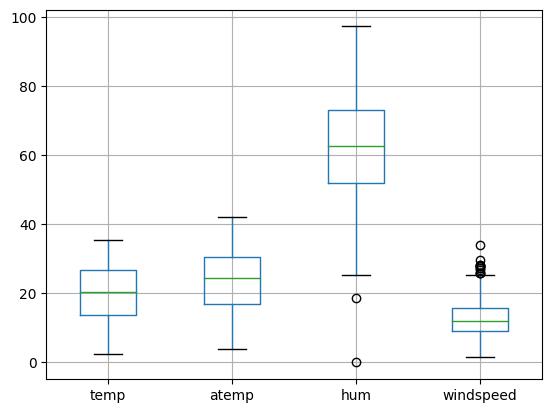

In [28]:
# Units are different but still can review the distribution
inversed_origin.boxplot()

Text(0.5, 0, 'daily time (# rows)')

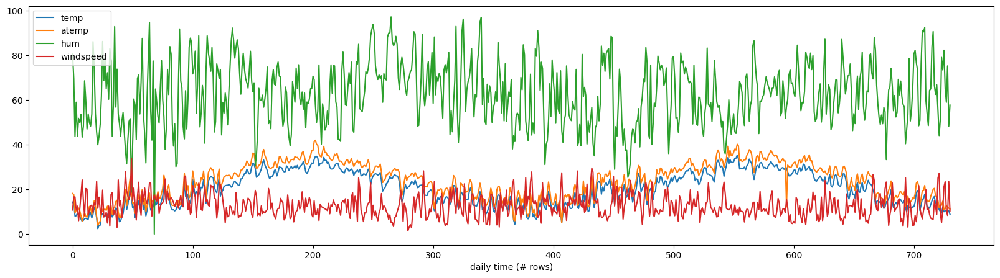

In [29]:
# Time series of the four features
ax = inversed_origin.set_index(inversed_origin.index).plot(figsize=(20,5))
ax.set_xlabel('daily time (# rows)')

In [30]:
X_original = pd.concat([cat_df, inversed_origin, inversed_df[['month', 'day', 'dayofweek']]], axis=1)
X_original # Use this for SHAP plot view

,winter,spring,summer,fall,holiday_0,holiday_1,workingday_0,workingday_1,clear,cloudy,lightsnow.rain,year_2011,year_2012,temp,atemp,hum,windspeed,month,day,dayofweek
0,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,14.110847,18.18125,80.5833,10.749882,1.0,1.0,5.0
1,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,14.902598,17.68695,69.6087,16.652113,1.0,2.0,6.0
2,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,0.0,8.050924,9.47025,43.7273,16.636703,1.0,3.0,0.0
3,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,0.0,8.200000,10.60610,59.0435,10.739832,1.0,4.0,1.0
4,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,0.0,9.305237,11.46350,43.6957,12.522300,1.0,5.0,2.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
726,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,10.420847,11.33210,65.2917,23.458911,12.0,27.0,3.0
727,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,10.386653,12.75230,59.0000,10.416557,12.0,28.0,4.0
728,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,10.386653,12.12000,75.2917,8.333661,12.0,29.0,5.0
729,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,1.0,10.489153,11.58500,48.3333,23.500518,12.0,30.0,6.0


In [31]:
# Create DataFrame with numerically scaled data
num_df = pd.DataFrame(data = numscaled, columns = num_var)
num_df

,temp,atemp,hum,windspeed,month,day,dayofweek
0,-0.826662,-0.679946,1.250171,-0.387892,-1.600161,-1.674108,0.996930
1,-0.721095,-0.740652,0.479113,0.749602,-1.600161,-1.560522,1.496077
2,-1.634657,-1.749767,-1.339274,0.746632,-1.600161,-1.446936,-1.498809
3,-1.614780,-1.610270,-0.263182,-0.389829,-1.600161,-1.333351,-0.999661
4,-1.467414,-1.504971,-1.341494,-0.046307,-1.600161,-1.219765,-0.500513
...,...,...,...,...,...,...,...
726,-1.318665,-1.521108,0.175807,2.061426,1.588660,1.279122,-0.001366
727,-1.323224,-1.346690,-0.266238,-0.452131,1.588660,1.392707,0.497782
728,-1.323224,-1.424344,0.878392,-0.853552,1.588660,1.506293,0.996930
729,-1.309558,-1.490049,-1.015664,2.069444,1.588660,1.619879,1.496077


Define X (input): Concatenate one hot encoded categorical + normalized numerical data

In [32]:
# Xdf: normalized
Xdf = pd.concat([cat_df, num_df], axis = 1)
Xdf.head(5)

,winter,spring,summer,fall,holiday_0,holiday_1,workingday_0,workingday_1,clear,cloudy,lightsnow.rain,year_2011,year_2012,temp,atemp,hum,windspeed,month,day,dayofweek
0,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,-0.826662,-0.679946,1.250171,-0.387892,-1.600161,-1.674108,0.996930
1,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,-0.721095,-0.740652,0.479113,0.749602,-1.600161,-1.560522,1.496077
2,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,0.0,-1.634657,-1.749767,-1.339274,0.746632,-1.600161,-1.446936,-1.498809
3,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,0.0,-1.614780,-1.610270,-0.263182,-0.389829,-1.600161,-1.333351,-0.999661
4,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,0.0,-1.467414,-1.504971,-1.341494,-0.046307,-1.600161,-1.219765,-0.500513


In [33]:
# Save column names for SHAP usage
NAMES = Xdf.columns
NAMES

Index(['winter', 'spring', 'summer', 'fall', 'holiday_0', 'holiday_1',
       'workingday_0', 'workingday_1', 'clear', 'cloudy', 'lightsnow.rain',
       'year_2011', 'year_2012', 'temp', 'atemp', 'hum', 'windspeed', 'month',
       'day', 'dayofweek'],
      dtype='object')

<AxesSubplot: >

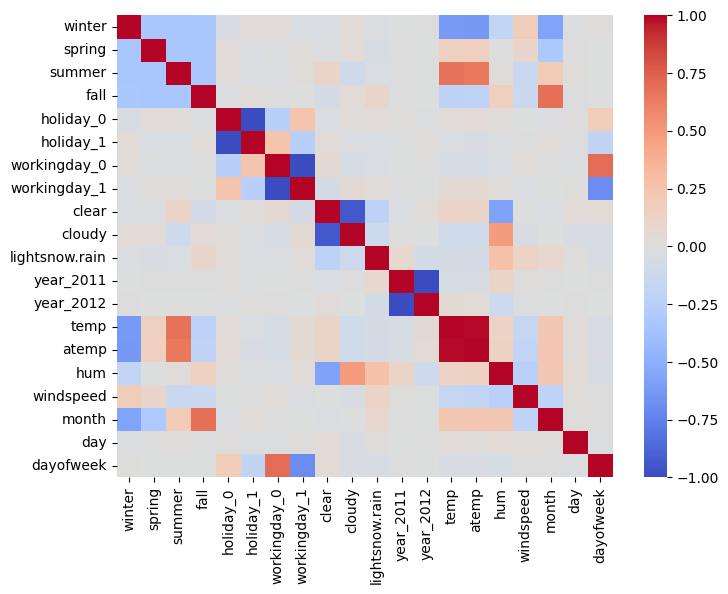

In [34]:
plt.subplots(figsize=(8, 6))
sb.heatmap(Xdf.corr(), cmap='coolwarm')

In [35]:
# Check if there is any non available
Xdf.isna().any().sum()

0

Define Y (to predict): Extract target

In [36]:
# Here, indicate which target to predict (cnt or casual or registered) 
to_predict = 'cnt'

In [37]:
# Here, indicate which target to predict (cnt or casual or registered) 
y = df[to_predict]

# Normalize target data: Calculate mean and standard deviation
y_mu = y.mean(0)
y_sd = y.std(0)

print('y mean:', y_mu, ' y std:' , y_sd)

y_norm = (y - y_mu) / y_sd
y_norm = y_norm.values.ravel() #dataframe to 1D array
#y_norm

y mean: 4504.3488372093025  y std: 1937.2114516187676


Split training and test data

In [38]:
np.random.seed(1234)
# Split the data into training, validation, and test data:
X_train, X_test, y_train, y_test = train_test_split(Xdf, y_norm, test_size = 0.2, random_state=1)
# Validation set
X_train, X_val, y_train, y_val = train_test_split(X_train, y_train, test_size=0.2, random_state=1) 

# Grid search and modeling

In [39]:
# A parameter grid for XGBoost
params = {
        'min_child_weight': [1, 5, 10],
        'gamma': [0.5, 1, 1.5, 2, 5],
        'subsample': [0.6, 0.8, 1.0],
        'colsample_bytree': [0.6, 0.8, 1.0],
        'max_depth': [3, 4, 5]
        }

In [40]:
# Build the model with 
# XGBoost Training Parameter Reference: 
#   https://github.com/dmlc/xgboost
#   https://xgboost.readthedocs.io/en/latest/parameter.html

# XGBRegressor object and GridSearch object
xgbmodel = xgb.XGBRegressor() 
clf = GridSearchCV(estimator = xgbmodel,
                   param_grid = params,
                   cv = 3,
                   verbose=1)

In [41]:
# Fit the training data to the GridSearch object
t0 = time.time()
clf.fit(X_train, y_train)
t1 = time.time()
print(t1-t0, " sec taken")

Fitting 3 folds for each of 405 candidates, totalling 1215 fits
68.90621089935303  sec taken


In [42]:
# Display the best parameters from the GridSearch
print(clf.best_params_)
print(clf.best_score_)

{'colsample_bytree': 0.8, 'gamma': 0.5, 'max_depth': 4, 'min_child_weight': 5, 'subsample': 0.8}
0.8633448414950647


# Train with best parameters

In [43]:
from sklearn._config import get_config, set_config
set_config(print_changed_only=False)

In [44]:
xgbmodel = xgb.XGBRegressor(**clf.best_params_, random_state=0)

In [45]:
# Fit the training data to the model
xgbmodel.fit(X_train, y_train, eval_set = [(X_train, y_train), (X_val, y_val)])

[0]	validation_0-rmse:0.84811	validation_1-rmse:0.86342
[1]	validation_0-rmse:0.67246	validation_1-rmse:0.69370
[2]	validation_0-rmse:0.54534	validation_1-rmse:0.58267
[3]	validation_0-rmse:0.45971	validation_1-rmse:0.50922
[4]	validation_0-rmse:0.40182	validation_1-rmse:0.45342
[5]	validation_0-rmse:0.36729	validation_1-rmse:0.40947
[6]	validation_0-rmse:0.33601	validation_1-rmse:0.38506
[7]	validation_0-rmse:0.31756	validation_1-rmse:0.37200
[8]	validation_0-rmse:0.30014	validation_1-rmse:0.36170
[9]	validation_0-rmse:0.28967	validation_1-rmse:0.35561
[10]	validation_0-rmse:0.28115	validation_1-rmse:0.34970
[11]	validation_0-rmse:0.27210	validation_1-rmse:0.34349
[12]	validation_0-rmse:0.27027	validation_1-rmse:0.33654
[13]	validation_0-rmse:0.26416	validation_1-rmse:0.33288
[14]	validation_0-rmse:0.25919	validation_1-rmse:0.33080
[15]	validation_0-rmse:0.25919	validation_1-rmse:0.33081
[16]	validation_0-rmse:0.25706	validation_1-rmse:0.32948
[17]	validation_0-rmse:0.25709	validation

XGBRegressor(base_score=None, booster=None, callbacks=None,
             colsample_bylevel=None, colsample_bynode=None,
             colsample_bytree=0.8, early_stopping_rounds=None,
             enable_categorical=False, eval_metric=None, feature_types=None,
             gamma=0.5, gpu_id=None, grow_policy=None, importance_type=None,
             interaction_constraints=None, learning_rate=None, max_bin=None,
             max_cat_threshold=None, max_cat_to_onehot=None,
             max_delta_step=None, max_depth=4, max_leaves=None,
             min_child_weight=5, missing=nan, monotone_constraints=None,
             n_estimators=100, n_jobs=None, num_parallel_tree=None,
             objective='reg:squarederror', predictor=None, ...)

# Predict

In [46]:
eval_result = xgbmodel.evals_result()
training_rounds = range(len(eval_result['validation_0']['rmse'])) #training
print(training_rounds)

range(0, 100)


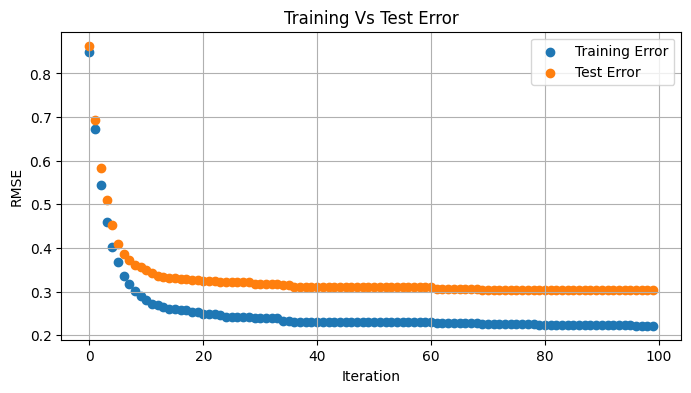

In [47]:
plt.figure(figsize=(8,4))
plt.scatter(x=training_rounds,y=eval_result['validation_0']['rmse'],label='Training Error')
plt.scatter(x=training_rounds,y=eval_result['validation_1']['rmse'],label='Test Error')
plt.grid(True)
plt.xlabel('Iteration')
plt.ylabel('RMSE')
plt.title('Training Vs Test Error')
plt.legend()
plt.show()

In [48]:
ypredicted = xgbmodel.predict(X_test) 

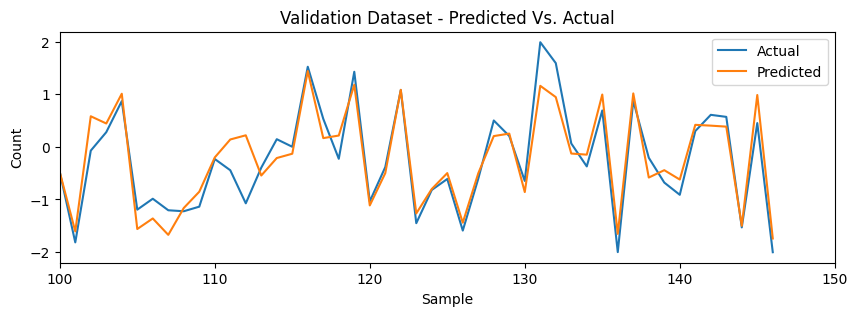

In [49]:
plt.figure(figsize=(10,3))
# Actual Vs Predicted
plt.plot(y_test, label='Actual')
plt.plot(ypredicted, label='Predicted')
plt.xlabel('Sample')
plt.ylabel('Count')
plt.xlim([100,150])
plt.title('Validation Dataset - Predicted Vs. Actual')
plt.legend()
plt.show()

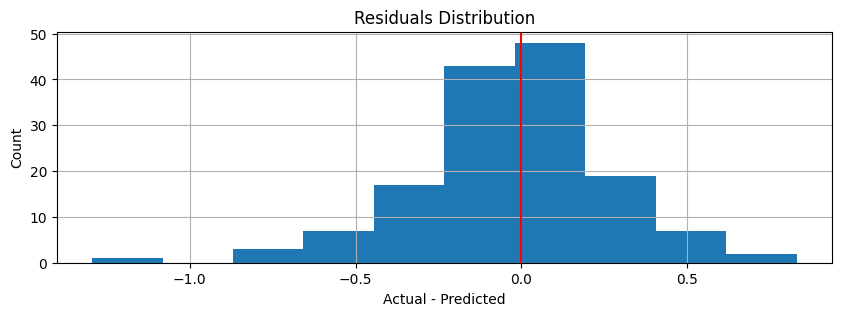

In [50]:
# Over prediction and Under Prediction needs to be balanced
# Training Data Residuals
residuals = (y_test - ypredicted) # * y_sd + y_mu (for actual cnt numbers)

plt.figure(figsize=(10,3))
plt.hist(residuals)
plt.grid(True)
plt.xlabel('Actual - Predicted')
plt.ylabel('Count')
plt.title('Residuals Distribution')
plt.axvline(color='r')
plt.show()

In [51]:
print("RMSE: {0:0.4f}".format(mean_squared_error(y_test, ypredicted)))

RMSE: 0.0884


In [52]:
# Show the influencing features in order (with feature_importances_)
# Indicate which parameter used to decide the ranking of important features
important_features = pd.Series(data=xgbmodel.feature_importances_, index=NAMES)
important_features.sort_values(ascending=False,inplace=True)
print(important_features)

# There are different parameters:
# Refer to, https://github.com/dmlc/xgboost/blob/master/python-package/xgboost/core.py
#        * 'weight': the number of times a feature is used to split the data across all trees.
#        * 'gain': the average gain across all splits the feature is used in.
#        * 'cover': the average coverage across all splits the feature is used in.
#        * 'total_gain': the total gain across all splits the feature is used in.
#        * 'total_cover': the total coverage across all splits the feature is used in.

year_2012         0.334441
month             0.148238
year_2011         0.093973
atemp             0.091646
winter            0.060549
fall              0.057606
clear             0.034687
cloudy            0.033488
temp              0.031691
lightsnow.rain    0.028922
hum               0.022926
windspeed         0.017095
workingday_0      0.010901
holiday_0         0.009047
day               0.007691
dayofweek         0.007369
workingday_1      0.007166
spring            0.002563
holiday_1         0.000000
summer            0.000000
dtype: float32


In [53]:
important_features = pd.Series(data=xgbmodel.get_booster().get_score(importance_type='gain'), index=NAMES)
important_features.sort_values(ascending=False,inplace=True)
print(important_features)

year_2012         24.965616
month             11.065815
year_2011          7.015013
atemp              6.841238
winter             4.519948
fall               4.300218
clear              2.589336
cloudy             2.499859
temp               2.365730
lightsnow.rain     2.159016
hum                1.711424
windspeed          1.276122
workingday_0       0.813745
holiday_0          0.675331
day                0.574106
dayofweek          0.550102
workingday_1       0.534939
spring             0.191319
summer                  NaN
holiday_1               NaN
dtype: float64


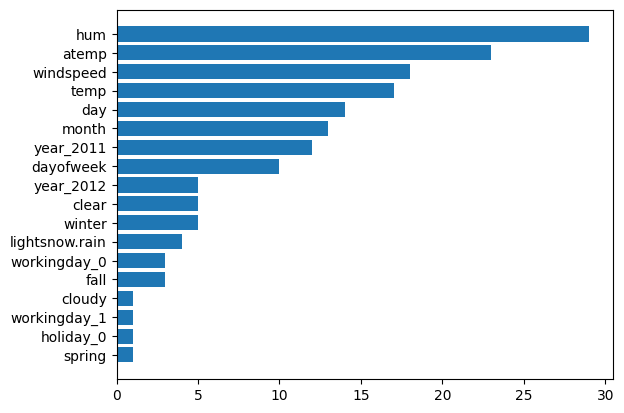

In [54]:
# Show the influencing features in order (with get_booster().get_fscore())
# fscore is based on the number of times a feature is used in a tree
fscore = xgbmodel.get_booster().get_fscore().items()
lists = sorted(fscore, key=lambda x:x[1]) # sorted by value, return a list of tuples
fkey, fvalue = zip(*lists) # unpack a list of pairs into two tuples

plt.barh(fkey, fvalue)
plt.show()

# Check which single instance to compare with SHAP

In [55]:
# Select from the test set
# when atemp Low/hum Higher[301]:cnt627  
test = X_test[ (X_test['atemp'] < -1) & (X_test['hum'] > 1)]
print(test.shape)
test.head(5)

(2, 20)


,winter,spring,summer,fall,holiday_0,holiday_1,workingday_0,workingday_1,clear,cloudy,lightsnow.rain,year_2011,year_2012,temp,atemp,hum,windspeed,month,day,dayofweek
35,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,-1.432558,-1.420304,2.116697,-0.379718,-1.310268,-1.219765,0.99693
301,0.0,0.0,0.0,1.0,1.0,0.0,1.0,0.0,0.0,0.0,1.0,1.0,0.0,-1.318665,-1.513304,1.788822,2.077411,1.008875,1.506293,0.99693


In [56]:
PICK = 301 #atempLow/humHigher[301]:cnt627      
Xdf[Xdf.index==PICK]

,winter,spring,summer,fall,holiday_0,holiday_1,workingday_0,workingday_1,clear,cloudy,lightsnow.rain,year_2011,year_2012,temp,atemp,hum,windspeed,month,day,dayofweek
301,0.0,0.0,0.0,1.0,1.0,0.0,1.0,0.0,0.0,0.0,1.0,1.0,0.0,-1.318665,-1.513304,1.788822,2.077411,1.008875,1.506293,0.99693


In [57]:
# review the target values, y[301] has target cnt = 627 which is a very low bike rental count
print("target count is:", y[301])

target count is: 627


In [58]:
# For comparison, keep the indices that were used for SHAP cases
SAMPLE1 = 364 #winter, weekend day (from test)
SAMPLE2 = 180 #summer, working day (from test)

# Select one day for investigation with a force plot later
weekEnd_sample = Xdf.loc[[SAMPLE1]]   #winter, weekend day (from test)
weekDay_sample = Xdf.loc[[SAMPLE2]]   #summer, working day (from test)

weekEnd_sample_origin = X_original.loc[[SAMPLE1]]
weekDay_sample_origin = X_original.loc[[SAMPLE2]]
weekEnd_sample 

,winter,spring,summer,fall,holiday_0,holiday_1,workingday_0,workingday_1,clear,cloudy,lightsnow.rain,year_2011,year_2012,temp,atemp,hum,windspeed,month,day,dayofweek
364,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,-0.466773,-0.369869,-0.084739,0.383083,1.58866,1.733465,0.99693


# Explain model with LIME

In [59]:
X_original.head(5)

,winter,spring,summer,fall,holiday_0,holiday_1,workingday_0,workingday_1,clear,cloudy,lightsnow.rain,year_2011,year_2012,temp,atemp,hum,windspeed,month,day,dayofweek
0,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,14.110847,18.18125,80.5833,10.749882,1.0,1.0,5.0
1,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,14.902598,17.68695,69.6087,16.652113,1.0,2.0,6.0
2,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,0.0,8.050924,9.47025,43.7273,16.636703,1.0,3.0,0.0
3,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,0.0,8.200000,10.60610,59.0435,10.739832,1.0,4.0,1.0
4,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,0.0,9.305237,11.46350,43.6957,12.522300,1.0,5.0,2.0


In [60]:
# let the LIME Explainer know which features are categorical
categorical_features = [0,1,2,3,4,5,6,7,8,9,10,11,12]

In [61]:
categorical_names = {}
for feature in categorical_features:    
    le = LabelEncoder()
    le.fit(Xdf.iloc[:, feature])
    categorical_names[feature] = le.classes_

In [62]:
# Initialize the explainer
# Note that this is a regression problem, not a classification
explainer = LimeTabularExplainer(X_train.values, feature_names=NAMES,
                                  categorical_features=categorical_features, 
                                  categorical_names=categorical_names,
                                  verbose=True, mode='regression')

# LIME Local explanation (one day)

In [63]:
print("winter, weekend day target count:", y[SAMPLE1])
print("summer, working day target count:", y[SAMPLE2])

winter, weekend day target count: 2485
summer, working day target count: 5515


,cnt
count,731.000000
mean,4504.348837
std,1937.211452
min,22.000000
25%,3152.000000
50%,4548.000000
75%,5956.000000
max,8714.000000


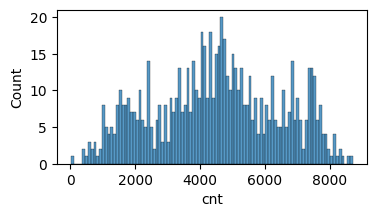

In [64]:
plt.figure(figsize=(4,2))
ax = sb.histplot(data=df, x="cnt", bins=100)
pd.DataFrame((df['cnt']).describe())

# Explain this one day: Weekend, Winter

In [65]:
weekEnd_sample_origin

,winter,spring,summer,fall,holiday_0,holiday_1,workingday_0,workingday_1,clear,cloudy,lightsnow.rain,year_2011,year_2012,temp,atemp,hum,windspeed,month,day,dayofweek
364,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,16.81,20.70605,61.5833,14.750318,12.0,31.0,5.0


In [66]:
# Explain one day: Weekend
# winter, weekend day target count: 2485
print("WEEKEND in Winter")
#Explanation object has information about features contributions to this particular prediction
exp_WE = explainer.explain_instance(weekEnd_sample.values[0], xgbmodel.predict, num_features=10)
exp_WE.show_in_notebook(show_all=False)

WEEKEND in Winter
Intercept -0.13717358059366633
Prediction_local [-0.57309594]
Right: -0.6958025


# Explanation
Based on the local model, the prediction value showed -0.597 while the actual model predicted -0.696, which is aligned and shows a negative rent prediction on this day.

The renting prediction is negatively affected by the year 2011 feature. Being winter and having a lower feeling temperature affect the rent prediction negatively.

Having no light snow or rain, low humidity, and clear skies raise the rent prediction, but not enough to push the scales toward positive.


In [67]:
# Explain one day: Weekend
# winter, weekend day target count: 2485
print("WEEKEND in Winter (restrict to 5 features)")
#Explanation object has information about features contributions to this particular prediction
exp_WE = explainer.explain_instance(weekEnd_sample.values[0], xgbmodel.predict, num_features=5)
exp_WE.show_in_notebook(show_all=False) 

WEEKEND in Winter (restrict to 5 features)
Intercept 0.26500944484935046
Prediction_local [-0.52061615]
Right: -0.6958025


In [68]:
# Feature-Contribution mapping
pd.DataFrame(exp_WE.as_list(),columns=['Feature','Contribution'])

,Feature,Contribution
0,year_2011=1.0,-0.520235
1,year_2012=0.0,-0.421981
2,winter=1.0,-0.212996
3,-0.73 < hum <= 0.04,0.195789
4,clear=1.0,0.173798


In [69]:
# same with LIME plot
#with plt.style.context("ggplot"):
#    exp_WE.as_pyplot_figure()

# Explain this one day: Weekday, Summer

In [70]:
# Change input to another day for local explanation: Weekday
#Explanation object has information about features contributions to this particular prediction
# summer, working day target count: 5515
print("WEEKDAY in Summer")
exp_wd = explainer.explain_instance(weekDay_sample.values[0], xgbmodel.predict, num_features=25)
exp_wd.show_in_notebook(show_all=False) 

WEEKDAY in Summer
Intercept -0.34924014881796034
Prediction_local [0.09830227]
Right: 0.22199456


In [71]:
# Note that the LIME prediction has changed with 5 features input in this case
# summer, working day target count: 5515
print("WEEKDAY in Summer (restrict to 5 features)")
exp_wd = explainer.explain_instance(weekDay_sample.values[0], xgbmodel.predict, num_features=5)
exp_wd.show_in_notebook(show_all=False) 

WEEKDAY in Summer (restrict to 5 features)
Intercept 0.16906834849247088
Prediction_local [-0.20076617]
Right: 0.22199456


In [72]:
pd.DataFrame(exp_wd.as_list(),columns=['Feature','Contribution'])

,Feature,Contribution
0,year_2011=1.0,-0.524257
1,year_2012=0.0,-0.435940
2,hum <= -0.73,0.214068
3,atemp > 0.82,0.191429
4,clear=1.0,0.184865


In [73]:
# how to get LIME Prediction value
exp_wd.intercept[1] + pd.DataFrame(exp_wd.as_list())[1].sum()

-0.20076616629950328

# Explore the relationship between atemp and humidity (compare w SHAP)

In [74]:
# Select one day for investigation
aL_hH = Xdf.loc[[301]] #atempLow/humHigher[301]:cnt627      
aL_hL = Xdf.loc[[368]] #atempLow/humLower[368]:cnt2368      
aH_hL = Xdf.loc[[551]] #atempHigh/humLower[551]:cnt6241      
aH_hA = Xdf.loc[[584]] #atempHigh/humAvg[584]:cnt7273      

aL_hH_origin = X_original.loc[[301]]
aL_hL_origin = X_original.loc[[368]]
aH_hL_origin = X_original.loc[[551]]
aH_hA_origin = X_original.loc[[584]]
aH_hA_origin

,winter,spring,summer,fall,holiday_0,holiday_1,workingday_0,workingday_1,clear,cloudy,lightsnow.rain,year_2011,year_2012,temp,atemp,hum,windspeed,month,day,dayofweek
584,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,30.169153,34.88105,70.375,7.832836,8.0,7.0,1.0


In [75]:
#1 [301]
print("atemp Lower/ hum Higher")
exp_aL_hH = explainer.explain_instance(aL_hH.values[0], xgbmodel.predict, num_features=5)
exp_aL_hH.show_in_notebook(show_all=False) 
#2 [368]
print("atemp Lower/ hum Lower")
exp_aL_hL = explainer.explain_instance(aL_hL.values[0], xgbmodel.predict, num_features=5)
exp_aL_hL.show_in_notebook(show_all=False) 
#3 [551]
print("atemp Higher/ hum Lower")
exp_aH_hL = explainer.explain_instance(aH_hL.values[0], xgbmodel.predict, num_features=5)
exp_aH_hL.show_in_notebook(show_all=False) 
#4 [584]
print("atemp Higher/ hum Average")
exp_aH_hA = explainer.explain_instance(aH_hA.values[0], xgbmodel.predict, num_features=5)
exp_aH_hA.show_in_notebook(show_all=False) 


atemp Lower/ hum Higher
Intercept 0.6834259351334523
Prediction_local [-1.49897929]
Right: -1.6550077


atemp Lower/ hum Lower
Intercept -0.26916617732582204
Prediction_local [-0.46064575]
Right: -0.8665453


atemp Higher/ hum Lower
Intercept -0.8553477926513701
Prediction_local [0.81260366]
Right: 0.89202654


atemp Higher/ hum Average
Intercept -0.8617095307885088
Prediction_local [0.79119369]
Right: 1.1825035


# Check the distribution

In [76]:
# normalized vs original: distribution of humidity, normalized value and ignore scientific format
df_hat_n = pd.DataFrame(Xdf['hum'].describe().apply(lambda x: format(x, 'f')))
df_hat_n['atemp'] = Xdf['atemp'].describe().apply(lambda x: format(x, 'f'))
df_hat_n['temp'] = Xdf['temp'].describe().apply(lambda x: format(x, 'f'))

df_hat = pd.DataFrame((df['hum']*100).describe())
df_hat['atemp'] = ((df['atemp']*50).describe())
df_hat['temp'] = ((df['temp']*41).describe())

In [77]:
display(df_hat)
display(df_hat_n)

,hum,atemp,temp
count,731.000000,731.000000,731.000000
mean,62.789406,23.717699,20.310776
std,14.242910,8.148059,7.505091
min,0.000000,3.953480,2.424346
25%,52.000000,16.892125,13.820424
50%,62.666700,24.336650,20.431653
75%,73.020850,30.430100,26.872076
max,97.250000,42.044800,35.328347


,hum,atemp,temp
count,731.000000,731.000000,731.000000
mean,-0.000000,0.000000,-0.000000
std,1.000685,1.000685,1.000685
min,-4.411486,-2.427296,-2.384871
25%,-0.758047,-0.838267,-0.865385
50%,-0.008621,0.076015,0.016117
75%,0.718845,0.824368,0.874845
max,2.421148,2.250800,2.002355


# Questions and Answers

**<span style="color:brown">In our journey to predict bike sharing demand, we embarked on a series of data-driven steps. We began by meticulously preparing the dataset, engineering features like date components, temperature, and weather conditions. Categorical variables were transformed, and numerical features standardized for consistency. With the groundwork laid, we turned to model selection and chose the robust XGBoostRegressor, known for its prowess in regression tasks. Hyperparameter tuning further optimized the model's predictive power, and we embarked on training, closely monitoring performance with an evaluation set. The fruits of our labor were revealed as we evaluated the model, achieving an impressive RMSE of 0.0884, a testament to its accuracy. We delved deeper into feature importance, unearthing insights into the factors influencing bike rental counts. To complete our journey, Lime and SHAP values illuminated individual predictions, unraveling the intricate web of feature contributions. With these insights, we stand ready to unlock the secrets of bike sharing demand.</span>**

- Constructing two models for casuals and registered considering them as target variables.

In [78]:
# Normalize 'casual' target variable
y_casual = df['casual']
y_casual_mu = y_casual.mean()
y_casual_sd = y_casual.std()

y_casual_norm = (y_casual - y_casual_mu) / y_casual_sd
y_casual_norm = y_casual_norm.values.ravel()  # Convert to 1D array if needed

# Normalize 'registered' target variable
y_registered = df['registered']
y_registered_mu = y_registered.mean()
y_registered_sd = y_registered.std()

y_registered_norm = (y_registered - y_registered_mu) / y_registered_sd
# Convert to 1D array if needed
y_registered_norm = y_registered_norm.values.ravel()

# Split for 'casual' target variable
X_train_casual, X_test_casual, y_train_casual, y_test_casual = train_test_split(
    Xdf, y_casual_norm, test_size=0.2, random_state=1)

# Validation set for 'casual' target variable
X_train_casual, X_val_casual, y_train_casual, y_val_casual = train_test_split(
    X_train_casual, y_train_casual, test_size=0.2, random_state=1)

# Split for 'registered' target variable
X_train_registered, X_test_registered, y_train_registered, y_test_registered = train_test_split(
    Xdf, y_registered_norm, test_size=0.2, random_state=1)

# Validation set for 'registered' target variable
X_train_registered, X_val_registered, y_train_registered, y_val_registered = train_test_split(
    X_train_registered, y_train_registered, test_size=0.2, random_state=1)

# Create and train the XGBoost model for 'casual' target variable
xgbmodel_casual = xgb.XGBRegressor(**clf.best_params_, random_state=0)
xgbmodel_casual.fit(X_train_casual, y_train_casual, eval_set=[
                    (X_train_casual, y_train_casual), (X_val_casual, y_val_casual)], verbose=False)

# Create and train the XGBoost model for 'registered' target variable
xgbmodel_registered = xgb.XGBRegressor(**clf.best_params_, random_state=0)
xgbmodel_registered.fit(X_train_registered, y_train_registered, eval_set=[(
    X_train_registered, y_train_registered), (X_val_registered, y_val_registered)], verbose=False)

# Initialize the explainer
# Note that this is a regression problem, not a classification
explainer_casual_lime = LimeTabularExplainer(X_train_casual.values, feature_names=NAMES,
                                  categorical_features=categorical_features, 
                                  categorical_names=categorical_names,
                                  verbose=True, mode='regression')

explainer_registered_lime = LimeTabularExplainer(X_train_registered.values, feature_names=NAMES,
                                  categorical_features=categorical_features, 
                                  categorical_names=categorical_names,
                                  verbose=True, mode='regression')

In [79]:
print("Casual_RMSE: {0:0.4f}".format(mean_squared_error(y_test_casual, xgbmodel_casual.predict(X_test_casual))))
print("Registered_RMSE: {0:0.4f}".format(mean_squared_error(y_test_registered,xgbmodel_registered.predict(X_test_registered))))

Casual_RMSE: 0.1727
Registered_RMSE: 0.0909


**<span style="color:brown">We performed a two-step process to build and explain the predictions of two different regression models for the 'casual' and 'registered' users of a bike-sharing system. We first normalized the target variables 'casual' and 'registered' to have zero mean and unit standard deviation. Then, we split the dataset into training, validation, and test sets for both target variables. We trained XGBoost regression models for each target variable separately and achieved low root mean square errors (RMSE) of 0.1727 for 'casual' and 0.0909 for 'registered' on the test sets, indicating good predictive performance.</span>**

***
***
***

<b> B-1. From the LIME tutorial, the ‘atemp (feeling temperature)’ and ‘humidity’ relationship (four categories) affect each day of the total counts of renting a bike. Change the target to explain the same (day) instance of a renting behavior for the ‘casual’ users and ‘registered’ users. The four instances are categorized as ‘atemp low/humidity higher’, ‘atemp low/humidity lower’, ‘atemp high/humidity lower’, and ‘atemp high/humidity average’. Show the four LIME visualizations for ‘casual’ users and ‘registered’ users, respectively.

In [80]:
tdf_describe = pd.concat([
    Xdf,

    pd.DataFrame(y_norm, columns=['cnt']), 
    pd.DataFrame(y_casual_norm, columns=['casual']), 
    pd.DataFrame(y_registered_norm, columns=['registered']),

    pd.DataFrame(y.values, columns=['denorm_cnt']),
    pd.DataFrame(y_casual.values, columns=['denorm_casual']),
    pd.DataFrame(y_registered.values, columns=['denorm_registered'])
], axis=1)

In [81]:
X_original.loc[:, 'temp':].describe().T

,count,mean,std,min,25%,50%,75%,max
temp,731.0,20.310776,7.505091,2.424346,13.820424,20.431653,26.872076,35.328347
atemp,731.0,23.717699,8.148059,3.953480,16.892125,24.336650,30.430100,42.044800
hum,731.0,62.789406,14.242910,0.000000,52.000000,62.666700,73.020850,97.250000
windspeed,731.0,12.762576,5.192357,1.500244,9.041650,12.125325,15.625371,34.000021
month,731.0,6.519836,3.451913,1.000000,4.000000,7.000000,10.000000,12.000000
day,731.0,15.738714,8.809949,1.000000,8.000000,16.000000,23.000000,31.000000
dayofweek,731.0,3.002736,2.004787,0.000000,1.000000,3.000000,5.000000,6.000000


In [82]:
tdf_describe.loc[:, 'temp':].describe().T

,count,mean,std,min,25%,50%,75%,max
temp,731.0,-4.179663e-16,1.000685,-2.384871,-0.865385,0.016117,0.874845,2.002355
atemp,731.0,2.916044e-17,1.000685,-2.427296,-0.838267,0.076015,0.824368,2.250800
hum,731.0,-9.914550e-16,1.000685,-4.411486,-0.758047,-0.008621,0.718845,2.421148
windspeed,731.0,-2.138432e-16,1.000685,-2.170506,-0.717107,-0.122813,0.551725,4.092936
month,731.0,3.888059e-17,1.000685,-1.600161,-0.730482,0.139196,1.008875,1.588660
day,731.0,-3.159048e-17,1.000685,-1.674108,-0.879008,0.029678,0.824779,1.733465
dayofweek,731.0,-1.458022e-17,1.000685,-1.498809,-0.999661,-0.001366,0.996930,1.496077
cnt,731.0,-7.776117e-17,1.000000,-2.313815,-0.698090,0.022533,0.749351,2.173047
casual,731.0,9.720147e-17,1.000000,-1.232375,-0.775792,-0.196872,0.360931,3.731051
registered,731.0,7.776117e-17,1.000000,-2.330497,-0.742937,0.003735,0.718041,2.108517


- Instances selected

In [83]:
aL_hH = Xdf.loc[[301]] #atempLow/humHigher  
aL_hL = Xdf.loc[[368]] #atempLow/humLower     
aH_hL = Xdf.loc[[551]] #atempHigh/humLower  
aH_hA = Xdf.loc[[584]] #atempHigh/humAvg    

aL_hH_origin = X_original.loc[[301]]
aL_hL_origin = X_original.loc[[368]]
aH_hL_origin = X_original.loc[[551]]
aH_hA_origin = X_original.loc[[584]]

In [84]:
tdf = pd.concat([X_original, pd.DataFrame(y.values, columns=['cnt']),
                  pd.DataFrame(y_registered.values, columns=['registered']), pd.DataFrame(y_casual.values, columns=['casual']),
                  pd.DataFrame(y_norm, columns=['norm_cnt']),
                  pd.DataFrame(y_registered_norm, columns=['norm_registered']), pd.DataFrame(y_casual_norm, columns=['norm_casual'])],axis = 1)
tdf.loc[[301, 368, 551, 584]][['temp', 'atemp', 'hum', 'windspeed', 'month',
       'day', 'dayofweek', 'cnt', 'registered', 'casual','norm_cnt','norm_registered','norm_casual']]

,temp,atemp,hum,windspeed,month,day,dayofweek,cnt,registered,casual,norm_cnt,norm_registered,norm_casual
301,10.420847,11.39565,88.2500,23.541857,10.0,29.0,5.0,627,570,57,-2.001510,-1.977991,-1.152273
368,4.407500,5.96685,41.4583,12.374900,1.0,4.0,2.0,2368,2273,95,-1.102796,-0.886503,-1.096930
551,33.927500,38.06835,45.7917,12.999943,7.0,5.0,3.0,6241,4836,1405,0.896470,0.756175,0.810960
584,30.169153,34.88105,70.3750,7.832836,8.0,7.0,1.0,7273,5995,1278,1.429194,1.499002,0.625997


- Casual

In [85]:
# Generate LIME explanations for 'casual' users

print("Casual: atemp Lower/ hum Higher")
explanation_aL_hH_casual = explainer_casual_lime.explain_instance(aL_hH.values[0], xgbmodel_casual.predict, num_features= len(NAMES))
explanation_aL_hH_casual.show_in_notebook(show_all=False)

print("Casual: atemp Lower/ hum Lower")
explanation_aL_hL_casual = explainer_casual_lime.explain_instance(aL_hL.values[0], xgbmodel_casual.predict, num_features= len(NAMES))
explanation_aL_hL_casual.show_in_notebook(show_all=False)

print("Casual: atemp Higher/ hum Lower")
explanation_aH_hL_casual = explainer_casual_lime.explain_instance(aH_hL.values[0], xgbmodel_casual.predict, num_features= len(NAMES))
explanation_aH_hL_casual.show_in_notebook(show_all=False)

print("Casual: atemp Higher/ hum Average")
explanation_aH_hA_casual = explainer_casual_lime.explain_instance(aH_hA.values[0], xgbmodel_casual.predict, num_features= len(NAMES))
explanation_aH_hA_casual.show_in_notebook(show_all=False)

plt.show()

Casual: atemp Lower/ hum Higher
Intercept 0.3091810057390725
Prediction_local [-0.6708669]
Right: -1.2245724


Casual: atemp Lower/ hum Lower
Intercept 0.8005780362045645
Prediction_local [-0.84878864]
Right: -1.1348224


Casual: atemp Higher/ hum Lower
Intercept 0.20983213497388956
Prediction_local [0.45443647]
Right: 0.06877786


Casual: atemp Higher/ hum Average
Intercept 0.44015121051918726
Prediction_local [0.34156283]
Right: 0.2863046


- Registered

In [86]:
# Generate LIME explanations for 'registered' users

print("Registered: atemp Lower/ hum Higher")
explanation_aL_hH_registered = explainer_registered_lime.explain_instance(aL_hH.values[0], xgbmodel_registered.predict, num_features= len(NAMES))
explanation_aL_hH_registered.show_in_notebook(show_all=False)

print("Registered: atemp Lower/ hum Lower")
explanation_aL_hL_registered = explainer_registered_lime.explain_instance(aL_hL.values[0], xgbmodel_registered.predict, num_features= len(NAMES))
explanation_aL_hL_registered.show_in_notebook(show_all=False)

print("Registered: atemp Higher/ hum Lower")
explanation_aH_hL_registered = explainer_registered_lime.explain_instance(aH_hL.values[0], xgbmodel_registered.predict, num_features= len(NAMES))
explanation_aH_hL_registered.show_in_notebook(show_all=False)

print("Registered: atemp Higher/ hum Average")
explanation_aH_hA_registered = explainer_registered_lime.explain_instance(aH_hA.values[0], xgbmodel_registered.predict, num_features= len(NAMES))
explanation_aH_hA_registered.show_in_notebook(show_all=False)

plt.show()

Registered: atemp Lower/ hum Higher
Intercept 0.6020147998711004
Prediction_local [-2.29179215]
Right: -2.0438547


Registered: atemp Lower/ hum Lower
Intercept -1.05439161588443
Prediction_local [-0.35706488]
Right: -0.47404242


Registered: atemp Higher/ hum Lower
Intercept -1.7848903311781283
Prediction_local [1.26498387]
Right: 1.05499


Registered: atemp Higher/ hum Average
Intercept -2.0189436251843995
Prediction_local [1.12330952]
Right: 1.2594922


***
***
***

<b> B-2. Based on ‘B-1’, compare the results of ‘casual’ users and ‘registered’ users and describe the similarities and differences.

Based on the single instance LIME explanation in this example and your comparison analysis, if you are the CEO of this bike rental company, what is your marketing strategy based on the findings?

**atemp Lower/ hum Higher**
- Casual:

    Based on the local model, the prediction for this day aligns with the actual model prediction, both showing a negative rent prediction. The renting prediction is negatively affected by low feeling temperature along with high humidity and being year 2011. Additionally, high windspeed, low temperature, light snow or rain and no clear skies contribute to this negative prediction. Being a non-working day on Saturday slightly raises the prediction, but not enough to push the scales towards positive.

* Registered:

    Based on the local model, the prediction for this day aligns with the actual model prediction, both showing a negative rent prediction. The renting prediction is negatively affected by the year 2011 feature, along  with light snow or rain and low feeling temperature. Additionally, being a non working day, high humidity, low temperature and high windspeed contribute to this negative prediction. Being a non winter season and the month is October raise the prediction, but not enough to push the scales towards positive.

- Similarities:
    - Both 'casual' and 'registered' user types have negative rental predictions.
    - 'year_2011' negatively affects rental predictions for both.
    - High windspeed, high humidity, light snow or rain, low feeling temperature and low temperature reduce bike rentals for both user types.

* Differences:
    - Non-working day on Saturday affects positively casual user rentals.
    - Non-working day affects negatively registered user rentals.
    - Non-winter season and month is October affect positively registered user rentals.

**atemp Lower/ hum Lower**
- Casual:

    Based on the local model, the prediction for this day aligns with the actual model prediction, both showing a negative rent prediction. The renting prediction is negatively affected on a working day along with low feeling temperature, low temperature, month of January and the day is Wednesday. Being year 2012 with low humidity and no light snow or rain raise the prediction, but not enough to push the scales towards positive.

* Registered:

    Based on the local model, the prediction for this day aligns with the actual model prediction, both showing a negative rent prediction. The renting prediction is negatively affected by low feeling temperature along with being the month of January, low temperature and being a winter season. Being year 2012 with no light snow or rain, a working day and low humidity raise the prediction, but not enough to push the scales towards positive.

- Similarities:
    - Both Casual and Registered predictions are negative, indicating a low number of bike rentals on the day.
    - Both are negatively affected by low feeling temperature and low temperature.
    - Being year 2012, low humidity and the absence of light snow or rain raise the predictions for both.
    - Month of January affect negatively the rental bikes for both users.

* Differences:
    - For Casual predictions, being a working day and day is Wednesday negatively affect the prediction, while for Registered predictions, working day raise the prediction.
    - For Registered predictions, winter season negatively affect the prediction.

**atemp Higher/ hum Lower**
- Casual:

   Based on the local model, the prediction for this day aligns with the actual model prediction, both showing a positive rent prediction. The renting prediction is positively affected by high feeling temperature along with being year 2012 and low humidity. Additionally, no light snow or rain, month of July, clear skies and high temperature contribute to this positive prediction. Being a working day on Thursday lowers the prediction, but not enough to push the scales toward negative.

* Registered:

   Based on the local model, the prediction for this day aligns with the actual model prediction, both showing a positive rent prediction. The renting prediction is positively affected by having no light snow or rain along with the year 2012 on a working day, high feeling temperature and being a non winter season. Additionally, the month of July, low humidity, higher temperature, and clear skies contribute to this positive prediction.

- Similarities:
    - Both Casual and Registered predictions are positive, indicating a higher number of bike rentals on this day.
    - Both are positively affected by the year 2012, high feeling temperature, low humidity, being the month of July, clear skies, no light snow or rain and high temperature.

* Differences:
    - For Casual predictions, being a working day on Thursday lowers the prediction, while for Registered predictions, being working day raises the prediction.

**atemp Higher/ hum Average**
- Casual:

    Based on the local model, the prediction for this day aligns with the actual model prediction, both showing a positive rent prediction. The renting prediction is positively affected by high feeling temperature along with the year 2012, low windspeed and no light snow or rain. Additionally, being the month of August and high temperature contribute to this positive prediction. Being a working, non holiday, day is Tuesday and no clear skies lower the prediction, but not enough to push the scales towards negative.

* Registered:

   Based on the local model, the prediction for this day aligns with the actual model prediction, both showing a positive rent prediction. The renting prediction is positively affected by no light snow or rain feature along with the year 2012, a working day and non winter season. Additionally, high feeling temperature, month of August, low windspeed and non holiday features contribute to this positive prediction. Having no clear skies lowers the prediction, but not enough to push the scales towards negative.

- Similarities:
    - Both Casual and Registered predictions are positive, indicating a high number of bike rentals on this day.
    - Both are positively affected by the year 2012, high feeling temperature, no light snow or rain, low windspeed and being the month of August.
    - For both Casual and Registered predicitons, having no clear skies lower the prediction.

* Differences:
    - For Casual predictions, being a working day on Tuesday and is a non holiday lower the prediction, while for Registered predictions, being a working day and is a non holiday affects positively meaning that they raise the prediction.

**Marketing Strategies**

As the CEO of this bike rental company, I would base my marketing strategy on the findings by tailoring it to the specific weather conditions and user segments. This approach allows us to maximize our rental business by responding to the preferences and behavior patterns of our customers. Here's the marketing strategies divided based on the different conditions:

- (atemp Lower/hum Higher & atemp Lower/hum Lower):
    - Seasonal Discounts: Offer special discounts and promotions during the winter months (January and beyond) to attract customers during unfavorable weather conditions.
    - Indoor Activities Promotion: Promote the use of our rental bikes for indoor activities, such as visiting museums, art galleries, or cozy cafes, especially on low-temperature days.
    - Maintenance Packages: Highlight the importance of regular maintenance and offer winter bike maintenance packages to ensure bikes are in excellent condition.
    - Customer Education: Educate customers about the benefits of cycling in cold weather, such as staying active and enjoying the beauty of winter landscapes.

* (atemp Lower/hum Higher & atemp Higher/hum Average):
    - Hydration Campaign: Emphasize the importance of staying hydrated on hot and humid days. Offer complimentary water bottles or discounts on refreshments to keep riders comfortable.
    - Evening Rides: Promote evening and early morning rides when the temperature is cooler and humidity is lower. Encourage customers to explore the city during more comfortable hours.
    - Clear Skies Campaign: Market bike rentals on days with clear skies, as these are ideal conditions for outdoor activities. Highlight the joy of biking under the sun.
    - Local Events: Partner with local events and festivals that take place during warm months to attract event attendees looking for convenient transportation.

- (atemp Higher/hum Lower):
    - Summer Vacation Packages: Create summer vacation packages that include bike rentals. Promote biking as a fun and healthy way to explore the city or scenic routes.
    - Weekday Work Commute: Encourage customers to use bikes as a means of daily commute to work, especially on weekdays. Highlight the cost-effectiveness and health benefits.
    - Bike Tours: Offer guided bike tours during sunny and dry days, showcasing popular tourist attractions.
    - Clear Skies Campaign: Similar to the high-humidity condition, market bike rentals on days with clear skies for optimal outdoor enjoyment.

* Special Days (Non-working day on Saturday / Working day on Wednesday):
    - Weekend Getaways: Promote bike rentals for weekend getaways or leisure activities on non-working Saturdays.
    - Midweek Commute: Encourage the use of bikes for midweek commutes and offer discounts to working professionals to reduce traffic congestion and promote a healthier lifestyle.
    - Group Discounts: Offer group rental discounts for friends, families, or coworkers to make it an appealing option for social and team-building activities.

- Seasonal Changes (Year 2011 vs. Year 2012 & Month of October vs. Month of August):
    - Year-End Clearance Sale: Clear out old bike inventory from the previous year with special discounts, especially as the new year begins.
    - Seasonal Transition Promotion: During months of seasonal transition, highlight the versatility of biking as a means of transportation, even as the weather changes.
    
By tailoring marketing strategies to different conditions, our bike rental company can effectively target the preferences and needs of various customer segments. This approach not only optimizes revenue but also enhances customer satisfaction and loyalty. Furthermore, staying agile and adaptable based on weather and other factors can help the business thrive in all conditions.

***
***
***

<b> B-3. Based on ‘B-1’, use SHAP for local explanations and describe the similarities and differences.

In [87]:
# activate javascript
shap.initjs()

# Causal
explainer_casual_shap = shap.TreeExplainer(xgbmodel_casual)

shap_values_casual_aL_hH = explainer_casual_shap.shap_values(aL_hH)
shap_values_casual_aL_hL = explainer_casual_shap.shap_values(aL_hL)
shap_values_casual_aH_hL = explainer_casual_shap.shap_values(aH_hL)
shap_values_casual_aH_hA = explainer_casual_shap.shap_values(aH_hA)

# Registered
explainer_registered_shap = shap.TreeExplainer(xgbmodel_registered)

shap_values_registered_aL_hH = explainer_registered_shap.shap_values(aL_hH)
shap_values_registered_aL_hL = explainer_registered_shap.shap_values(aL_hL)
shap_values_registered_aH_hL = explainer_registered_shap.shap_values(aH_hL)
shap_values_registered_aH_hA = explainer_registered_shap.shap_values(aH_hA)

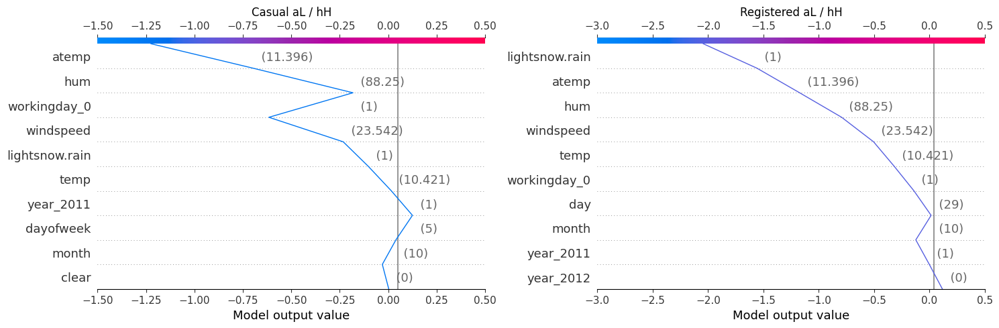

In [88]:
# atemp Lower/ hum Higher

plt.figure(figsize=(15, 5))

# Plot casual and registered
plt.subplot(1, 2, 1)
shap.decision_plot(explainer_casual_shap.expected_value, shap_values_casual_aL_hH, aL_hH_origin,
                   feature_names=NAMES.values, show= False, xlim=(-1.5, 0.5), auto_size_plot= False, feature_display_range=slice(None, -11, -1))
plt.title("Casual aL / hH")

plt.subplot(1, 2, 2)
shap.decision_plot(explainer_registered_shap.expected_value, shap_values_registered_aL_hH, aL_hH_origin,
                   feature_names=NAMES.values, show= False, xlim=(-3, 0.5), auto_size_plot= False, feature_display_range=slice(None, -11, -1))
plt.title("Registered aL / hH")

# Adjust layout and display the plots
plt.tight_layout()
plt.show()

**atemp Lower/ hum Higher**
- Casual:

  The SHAP local explanation model suggests a negative impact on this day for casual users, with a value ranging between -1 and -1.25. Although being a non working day on Saturday on the month of October push the renting probability higher, the low feeling temperature, high humidity, high windspeed, presence of light snow or rain, low temperature, being the year of 2011 and no clear skies decrease the effect towards renting a bike.

* Registered:

  The SHAP local explanation model indicates a negative impact on this day for registered users, with a value ranging between -2 and -2.5. Although being the month of October pushes the renting probability higher, presence of light snow or rain, low feeling temperature, high humidity, high windspeed, low temperature, being a non working day, day 29th of the month and being the year 2011 decrease the effect towards renting a bike.

- Similarities:
  - Both casual and registered users receive negative predictions, indicating a low number of expected bike rentals.
  - High humidity, high windspeed, presence light snow or rain, low feeling temperature, low temperature, and the feature of being in the year 2011 all contribute to the negative rental predictions for both user types.
  - Both casual and registered users are positively affected by the month of October.

* Differences:
  - Casual users are more positively influenced by the feature of a non-working day on Saturday, which raises their prediction. In contrast, being a non working day on the day 29th of the month has a negative impact on registered users' predictions.
  - No clear skies feature lowers the prediction for casual users.

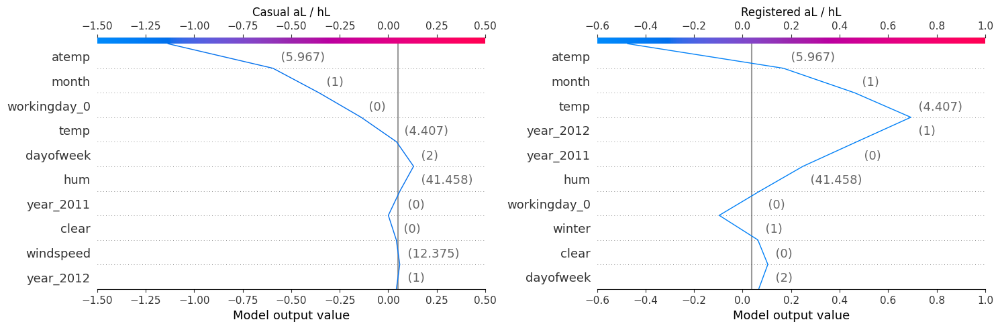

In [89]:
# atemp Lower/ hum Lower

plt.figure(figsize=(15, 5))

plt.subplot(1, 2, 1)
shap.decision_plot(explainer_casual_shap.expected_value, shap_values_casual_aL_hL, aL_hL_origin,
                   feature_names=NAMES.values, show= False, xlim=(-1.5, 0.5), auto_size_plot= False, feature_display_range=slice(None, -11, -1))
plt.title("Casual aL / hL")

plt.subplot(1, 2, 2)
shap.decision_plot(explainer_registered_shap.expected_value, shap_values_registered_aL_hL, aL_hL_origin,
                   feature_names=NAMES.values, show= False, xlim=(-0.6, 1), auto_size_plot= False, feature_display_range=slice(None, -11, -1))
plt.title("Registered aL / hL")

# Adjust layout and display the plots
plt.tight_layout()
plt.show()

**atemp Lower/ hum Lower**
- Casual:

  The SHAP local explanation model suggests a negative impact on this day for casual users, with a value ranging between -1 and -1.25. Although low humidity and year 2012 push the renting probability higher, the low feeling temperature, month of January, being a working day, low temperature, day is Wednesday and no clear skies decrease the effect towards renting a bike.

* Registered:

  The SHAP local explanation model suggests a negative impact on this day for registered users, with a value ranging between -0.4 and -0.6. Although year 2012, low humidity and is a working day on Wednesday push the renting probability higher, the low feeling temperature, month of January, low temperature, winter season and no clear skies decrease the effect towards renting a bike.

- Similarities:
  - Both 'casual' and 'registered' user predictions are in the negative range, indicating a low number of bike rentals on the specified day.
  - Low feeling temperature, month of January, low temperature and no clear skies features affect negatively on both casual and registered users.
  - Year 2012 and low humidity affect positively on both casual and registered users.

* Differences:
  - While working day and day is Wednesday negatively affects bike rental predictions for casual users, it has a contrasting effect on registered user predictions, raising them.
  - In the case of registered user predictions, the winter season has a negative impact, further decreasing predictions.

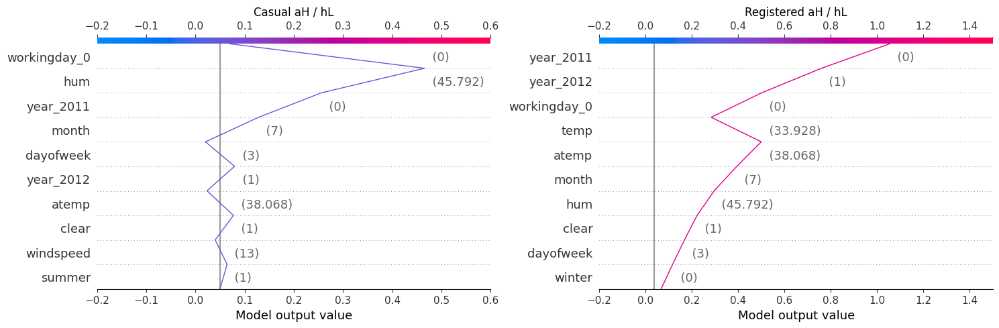

In [90]:
# atemp Higher/ hum Lower

plt.figure(figsize=(15, 5))

plt.subplot(1, 2, 1)
shap.decision_plot(explainer_casual_shap.expected_value, shap_values_casual_aH_hL, aH_hL_origin,
                   feature_names=NAMES.values, show= False, xlim=(-0.2, 0.6), auto_size_plot= False, feature_display_range=slice(None, -11, -1))
plt.title("Casual aH / hL")

plt.subplot(1, 2, 2)
shap.decision_plot(explainer_registered_shap.expected_value, shap_values_registered_aH_hL, aH_hL_origin,
                   feature_names=NAMES.values, show= False, xlim=(-0.2, 1.5), auto_size_plot= False, feature_display_range=slice(None, -11, -1))
plt.title("Registered aH / hL")

# Adjust layout and display the plots
plt.tight_layout()
plt.show()

**atemp Higher/ hum Lower**
- Casual:

  The SHAP local explanation model suggests a positive impact on this day for casual users, with a value ranging between 0 and 0.1. Although being a working day, day is Thursday, high feeling temperature and exceeding the average windspeed push the renting probability lower, low humidity, being year 2012, month of July, clear skies and is a summer season increase the effect towards renting a bike.

* Registered:

  The SHAP local explanation model suggests a positive impact on this day for registered users, with a value ranging between 1 and 1.2. Although high temperature pushes the renting probability lower, year 2012, being a working day, high feeling temperature, month of July, low humidity, clear skies, day is Thursday and is non winter season increase the effect towards renting a bike.

- Similarities:
  - Both 'casual' and 'registered' user predictions are in the positive range, indicating a high number of bike rentals on the specified day.
  - Low humidity, year 2012, month of July, clear skies are common features that higher the predictions for both casual and registered users.

* Differences:
  - While it is a working day, day is Thursday and high feeling temperature negatively affects bike rental predictions for casual users, it has a contrasting effect on registered user predictions, raising them.
  - Exceeding the average windpseed lower the prediction for casual users.
  - Summer season higher the prediction for casual users.
  - Non winter season higher the prediction for registered users.
  - High temperature lowers the prediction for registered users.

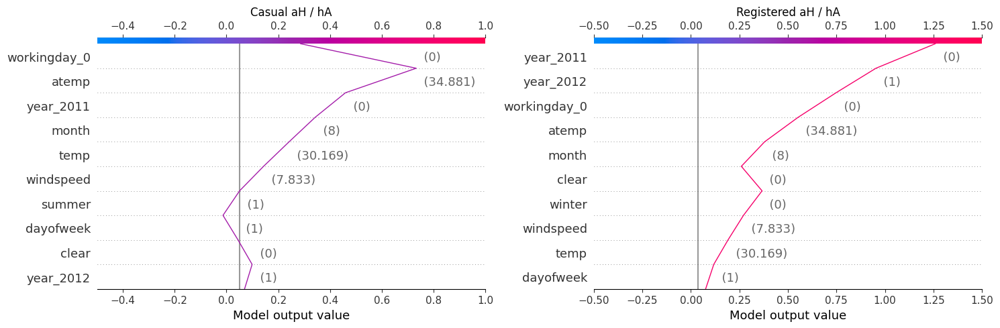

In [91]:
# atemp Higher/ hum Average

plt.figure(figsize=(15, 5))

plt.subplot(1, 2, 1)
shap.decision_plot(explainer_casual_shap.expected_value, shap_values_casual_aH_hA, aH_hA_origin,
                   feature_names=NAMES.values, show= False, xlim=(-0.5, 1), auto_size_plot= False, feature_display_range=slice(None, -11, -1))
plt.title("Casual aH / hA")

plt.subplot(1, 2, 2)
shap.decision_plot(explainer_registered_shap.expected_value, shap_values_registered_aH_hA, aH_hA_origin,
                   feature_names=NAMES.values, show= False, xlim=(-0.5, 1.5), auto_size_plot= False, feature_display_range=slice(None, -11, -1))
plt.title("Registered aH / hA")

# Adjust layout and display the plots
plt.tight_layout()
plt.show()

**atemp Higher/ hum Average**
- Casual:

  The SHAP local explanation model suggests a positive impact on this day for casual users, with a value ranging between 0.2 and 0.4. Although being a working day, day is Tuesday and no clear skies push the renting probability lower, high feeling temperature, being year 2012, month of August, high temperature, low windspeed and is a summer season increase the effect towards renting a bike.

* Registered:

  The SHAP local explanation model suggests a positive impact on this day for registered users, with a value ranging between 1.25 and 1.5. Although no clear skies push the renting probability lower, year 2012, being a working day, high feeling temperature, month of August, non winter season, low windspeed, high temperature and the day is Tuesday increase the effect towards renting a bike.

- Similarities:
  - Both 'casual' and 'registered' user predictions are in the positive range, indicating a high number of bike rentals on the specified day.
  - High feeling temperature, month of August, high temperature and low windspeed features affect positively towards renting a bike.
  - For casual and registered users, no clear skies affects negatively towards renting a bike.

* Differences:
  - While it is a working day and the day is Tuesday negatively affects bike rental predictions for casual users, it has a contrasting effect on registered user predictions, raising them.
  - Summer season higher the prediction for casual users.
  - Non winter season higher the prediction for registered users.

***
***
***

<b> B-4. Find two day-instances for bike renting on a working day and weekend targeting a casual user and two other days for bike renting on a working day and weekend targeting a registered user. Note that the model for a casual user and a registered user is different since the targets are different. Given the four instances, show the four LIME visualizations. The four instances are categorized as ‘a working day/casual user’, ‘a working day/registered user’, ‘a weekend/casual user’, and ‘a weekend/registered user’.

In [92]:
X_original.loc[:, 'temp':].describe().T

,count,mean,std,min,25%,50%,75%,max
temp,731.0,20.310776,7.505091,2.424346,13.820424,20.431653,26.872076,35.328347
atemp,731.0,23.717699,8.148059,3.953480,16.892125,24.336650,30.430100,42.044800
hum,731.0,62.789406,14.242910,0.000000,52.000000,62.666700,73.020850,97.250000
windspeed,731.0,12.762576,5.192357,1.500244,9.041650,12.125325,15.625371,34.000021
month,731.0,6.519836,3.451913,1.000000,4.000000,7.000000,10.000000,12.000000
day,731.0,15.738714,8.809949,1.000000,8.000000,16.000000,23.000000,31.000000
dayofweek,731.0,3.002736,2.004787,0.000000,1.000000,3.000000,5.000000,6.000000


In [93]:
tdf_describe.loc[:, 'temp':].describe().T

,count,mean,std,min,25%,50%,75%,max
temp,731.0,-4.179663e-16,1.000685,-2.384871,-0.865385,0.016117,0.874845,2.002355
atemp,731.0,2.916044e-17,1.000685,-2.427296,-0.838267,0.076015,0.824368,2.250800
hum,731.0,-9.914550e-16,1.000685,-4.411486,-0.758047,-0.008621,0.718845,2.421148
windspeed,731.0,-2.138432e-16,1.000685,-2.170506,-0.717107,-0.122813,0.551725,4.092936
month,731.0,3.888059e-17,1.000685,-1.600161,-0.730482,0.139196,1.008875,1.588660
day,731.0,-3.159048e-17,1.000685,-1.674108,-0.879008,0.029678,0.824779,1.733465
dayofweek,731.0,-1.458022e-17,1.000685,-1.498809,-0.999661,-0.001366,0.996930,1.496077
cnt,731.0,-7.776117e-17,1.000000,-2.313815,-0.698090,0.022533,0.749351,2.173047
casual,731.0,9.720147e-17,1.000000,-1.232375,-0.775792,-0.196872,0.360931,3.731051
registered,731.0,7.776117e-17,1.000000,-2.330497,-0.742937,0.003735,0.718041,2.108517


- Casual instances selected

In [94]:
tdf.loc[[679, 599]][['temp', 'atemp', 'hum', 'windspeed', 'month',
       'day', 'dayofweek', 'cnt', 'registered', 'casual','norm_cnt','norm_registered','norm_casual']]

,temp,atemp,hum,windspeed,month,day,dayofweek,cnt,registered,casual,norm_cnt,norm_registered,norm_casual
679,15.955847,19.69685,64.5417,3.875669,11.0,10.0,5.0,6536,4446,2090,1.048750,0.506217,1.808597
599,27.367500,31.09270,67.7083,4.708981,8.0,22.0,2.0,7375,6281,1094,1.481847,1.682305,0.358018


In [95]:
weekEnd_instance_casual = Xdf.loc[[679]]
weekDay_instance_casual = Xdf.loc[[599]]

weekEnd_instance_casual_origin = X_original.loc[[679]]
weekDay_instance_casual_origin = X_original.loc[[599]]

- Registered instances selected

In [96]:
tdf.loc[[568, 527]][['temp', 'atemp', 'hum', 'windspeed', 'month',
       'day', 'dayofweek', 'cnt', 'registered', 'casual','norm_cnt','norm_registered','norm_casual']]

,temp,atemp,hum,windspeed,month,day,dayofweek,cnt,registered,casual,norm_cnt,norm_registered,norm_casual
568,27.367500,31.15625,76.2500,6.292694,7.0,22.0,6.0,7410,4866,2544,1.499914,0.775403,2.469805
527,29.554153,32.98605,58.7917,13.916771,6.0,11.0,0.0,6664,5647,1017,1.114825,1.275962,0.245875


In [97]:
weekEnd_instance_registered = Xdf.loc[[568]]
weekDay_instance_registered = Xdf.loc[[527]]

weekEnd_instance_registered_origin = X_original.loc[[568]]
weekDay_instance_registered_origin = X_original.loc[[527]]

- Casual

In [98]:
print("Casual: WeekEnd")
explanation_weekEnd_instance_casual = explainer_casual_lime.explain_instance(weekEnd_instance_casual.values[0], xgbmodel_casual.predict, num_features= len(NAMES))
explanation_weekEnd_instance_casual.show_in_notebook(show_all=False)

print("Casual: WeekDay")
explanation_weekDay_instance_casual = explainer_casual_lime.explain_instance(weekDay_instance_casual.values[0], xgbmodel_casual.predict, num_features= len(NAMES))
explanation_weekDay_instance_casual.show_in_notebook(show_all=False)

Casual: WeekEnd
Intercept -0.5857853264085
Prediction_local [1.18101441]
Right: 0.69306415


Casual: WeekDay
Intercept 0.3836248747047357
Prediction_local [0.41178595]
Right: 0.42757332


- Registered

In [99]:
print("Registered: WeekEnd")
explanation_weekEnd_instance_registered = explainer_registered_lime.explain_instance(weekEnd_instance_registered.values[0], xgbmodel_registered.predict, num_features= len(NAMES))
explanation_weekEnd_instance_registered.show_in_notebook(show_all=False)

print("Registered: WeekDay")
explanation_weekDay_instance_registered = explainer_registered_lime.explain_instance(weekDay_instance_registered.values[0], xgbmodel_registered.predict, num_features= len(NAMES))
explanation_weekDay_instance_registered.show_in_notebook(show_all=False)

Registered: WeekEnd
Intercept -1.0607055038603572
Prediction_local [0.35156456]
Right: 0.3405328


Registered: WeekDay
Intercept -1.7620124302385565
Prediction_local [1.10937182]
Right: 1.1087222


***
***
***

<b> B-5. Based on ‘B-4’, compare the results of ‘casual’ users and ‘registered’ users and describe the similarities and differences.

Based on the single instance LIME explanation in this example and your comparison analysis, if you are the CEO of this bike rental company, what is your marketing strategy based on the findings? 

**WeekEnd**:
- Casual:

    Based on the local model, the prediction for this day aligns with the actual model prediction, both showing a positive rent prediction. The renting prediction is positively affected by non working day feature along with year 2012 and the day is Saturday. Additionally, low windspeed and clear skies contribute to this positive prediction.

* Registered:

    Based on the local model, the prediction for this day aligns with the actual model prediction, both showing a positive rent prediction. The renting prediction is positively affected by the year 2012 feature along with the absence of light snow or rain and high feeling temperature. Additionally, being a non winter season, month of July and low windspeed contribute to this positive prediction. Being a non working day with high humidity lower the prediction, but not enough to push the scales towards negative.

- Similarities:
    - Both 'casual' and 'registered' user types have positive rental predictions.
    - 'year_2012' positively affects rental predictions for both type of users.
    - Low windspeed increase bike rentals for both user types.

* Differences:
    - For Casual users, being a non working day and the day is Saturday higher the prediction, while for Registered users, being a non working day with high humidity lower the prediction.
    - Non winter season, high feeling temperature, absence of light snow or rain and month is July affect positively registered user rentals.
    - Clear skies feature higher the prediction for casual users.

**WeekDay**:
- Casual:

    Based on the local model, the prediction for this day aligns with the actual model prediction, both showing a positive rent prediction. The renting prediction is positively affected by high feeling temperature along with year 2012 and low windspeed. Additionally, the absence of light snow or rain, month of August and high temperature contribute to this positive prediction. Being a working day and the day is Wednesday lower the prediction, but not enough to push the scales towards negative.

* Registered:

    Based on the local model, the prediction for this day aligns with the actual model prediction, both showing a positive rent prediction. The renting prediction is positively affected by the year 2012 feature along with the absence of light snow or rain and is a working day. Additionally, high feeling temperature, non winter season, not a high humidity, month of June and high temperature contribute to this positive prediction.

- Similarities:
    - Both 'casual' and 'registered' predictions align with the actual model predictions, indicating positive predictions.
    - Being year 2012, absence of light snow or rain, high feeling temperature, high temperature has a positive influence on rental predictions for both user types.

* Differences:
    - For casual users, being a working day and day is Wednesday lower the prediction, while for registered users, being a working day higher the prediction.
    - For casual users month of August and low windspeed higher the prediction.
    - For registered users non winter season, not high humidity and month of June higher the prediction.

**Marketing Strategies**

As the CEO of this bike rental company, the findings from the comparison analysis provide valuable insights into the factors that influence bike rental demand for both casual and registered users on weekends and weekdays. Based on these insights, we can formulate a targeted marketing strategy to maximize rental revenue. Here's a strategy outline:

- Weekend Marketing Strategy:
    * Casual Users:
        - Capitalize on the positive impact of non-working days on Saturdays by offering special weekend promotions and discounts for casual users.
        - Highlight clear skies and good weather conditions to encourage outdoor activities.

    - Registered Users:
        - Emphasize the benefits of renting a bike on the weekend, especially in non-winter seasons like July.
        - Promote loyalty programs or special offers for registered users.

    * General:
        - Run social media and online ad campaigns that focus on the advantages of weekend rentals, such as leisure and recreation.
        - Ensure our bikes are well-maintained and available in sufficient quantities during weekends to meet the increased demand.

* Weekday Marketing Strategy:
    - Casual Users:
        - Consider targeting tourists or occasional riders by promoting bike rentals on weekdays in August when the feeling temperature is high.
        - Highlight the convenience of renting a bike for city exploration during working days and suggest it as an alternative to commuting.

    * Registered Users:
        - Focus on promoting weekday rentals to registered users, especially those who use bikes for commuting.
        - Consider loyalty programs or reduced rates for registered users during the week to incentivize consistent usage.

    - General:
        - Run weekday-specific ad campaigns that emphasize the practicality and cost-effectiveness of bike rentals during the workweek.
        - Ensure that bikes are readily available at key locations during the weekdays, particularly on working days.

- Year-Round Marketing Strategy:
    - Continue to highlight the positive influence of factors like "year_2012" and "low windspeed" for both casual and registered users.
    - Consider offering long-term rental options or subscription services for customers who prefer using bikes consistently, regardless of the day or season.

* Data-Driven Decision Making:
    - Regularly analyze user data to identify emerging trends and adapt marketing strategies accordingly.
    - Invest in data analytics and predictive modeling to gain a competitive edge in understanding customer preferences and demand fluctuations.

- Customer Engagement:
    - Maintain strong customer engagement through newsletters, social media, and customer feedback mechanisms.
    - Encourage reviews and referrals by providing incentives for satisfied customers to promote our services to their networks.

By tailoring our marketing strategy to the specific preferences and behaviors of casual and registered users on weekends and weekdays, we can optimize our rental business, increase customer satisfaction, and ultimately drive higher revenue.

***
***
***

<b> B-6. Based on ‘B-4’, use SHAP for local explanations and describe the similarities and differences.

In [100]:
shap_values_casual_weekEnd_instance = explainer_casual_shap.shap_values(weekEnd_instance_casual)
shap_values_casual_weekDay_instance = explainer_casual_shap.shap_values(weekDay_instance_casual)

shap_values_registered_weekEnd_instance = explainer_registered_shap.shap_values(weekEnd_instance_registered)
shap_values_registered_weekDay_instance = explainer_registered_shap.shap_values(weekDay_instance_registered)

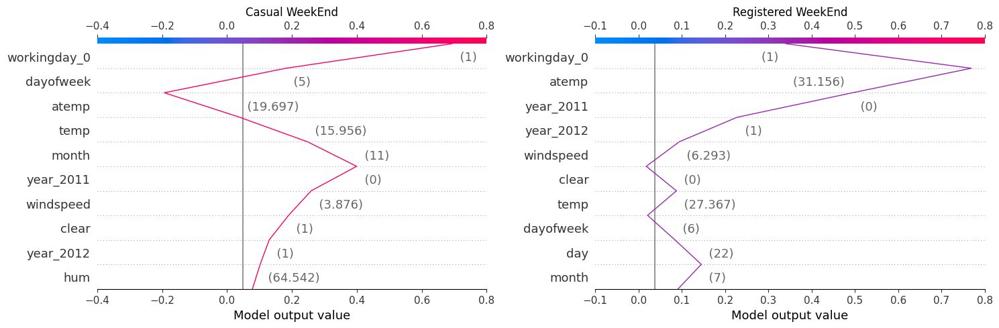

In [101]:
# Plot casual and registered for the weekend

plt.figure(figsize=(15, 5))

# Plot casual and registered for the weekend on the first row
plt.subplot(1, 2, 1)
shap.decision_plot(explainer_casual_shap.expected_value, shap_values_casual_weekEnd_instance,
                   weekEnd_instance_casual_origin, feature_names=NAMES.values, show=False, auto_size_plot= False, xlim=(-0.4, 0.8), feature_display_range=slice(None, -11, -1))
plt.title("Casual WeekEnd")

plt.subplot(1, 2, 2)
shap.decision_plot(explainer_registered_shap.expected_value, shap_values_registered_weekEnd_instance,
                   weekEnd_instance_registered_origin, feature_names=NAMES.values, show= False, auto_size_plot= False, xlim=(-0.1, 0.8), feature_display_range=slice(None, -11, -1))
plt.title("Registered WeekEnd")

# Adjust layout and display the plots
plt.tight_layout()
plt.show()

**WeekEnd**
- Casual:

  The SHAP local explanation model suggests a positive impact on this day for casual users, with a value ranging between 0.6 and 0.8. Although below average feeling temperature, below average temperature and month is November push the renting probability lower, being a non working day, day is Saturday, year 2012, low windspeed, clear skies and above average humidity increase the effect towards renting a bike.

* Registered:

  The SHAP local explanation model suggests a positive impact on this day for registered users, with a value ranging between 0.3 and 0.4. Although being a non working day, no clear skies, day is Sunday and it is the day 22nd of the month push the renting probability lower, high feeling temperature, year 2012, low windspeed, high temperature and the month is July increase the effect towards renting a bike.

- Similarities:
  - Both 'casual' and 'registered' user predictions are in the positive range.
  - Both casual and registered users are positively affected by the year 2012 and low windspeed.

* Differences:
  - For casual users, being a non working day on Saturday affect positively the rental predictions, while for registered users, being a non working day on Sunday affect negatively the rental predictions.
  - For casual users, below average feeling temperature, below average temperature and month is November push the renting probability lower.
  - For casual users, clear skies and above average humidity increase the effect towards renting a bike.
  - For registered users, no clear skies and the day is 22nd of the month push the renting probability lower.
  - For registered users, high feeling temperature, high temperature and month is July increase the effect towards renting a bike.

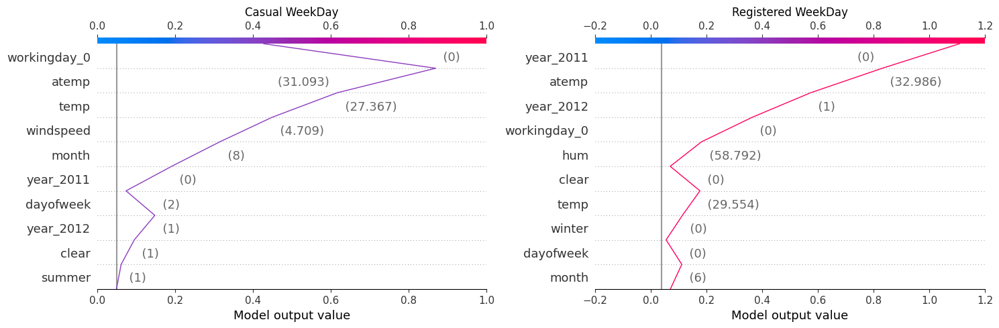

In [102]:
# Plot casual and registered for the weekday

plt.figure(figsize=(15, 5))

plt.subplot(1, 2, 1)
shap.decision_plot(explainer_casual_shap.expected_value, shap_values_casual_weekDay_instance,
                   weekDay_instance_casual_origin, feature_names=NAMES.values, show= False, auto_size_plot= False, xlim=(0, 1), feature_display_range=slice(None, -11, -1))
plt.title("Casual WeekDay")

plt.subplot(1, 2, 2)
shap.decision_plot(explainer_registered_shap.expected_value, shap_values_registered_weekDay_instance,
                   weekDay_instance_registered_origin, feature_names=NAMES.values, show= False, auto_size_plot= False, xlim=(-0.2, 1.2), feature_display_range=slice(None, -11, -1))
plt.title("Registered WeekDay")

# Adjust layout and display the plots
plt.tight_layout()
plt.show()

**WeekDay**
- Casual:

  The SHAP local explanation model suggests a positive impact on this day for casual users, with a value ranging between 0.4 and 0.6. Although being a working day and the day is Wednesday push the renting probability lower, high feeling temperature, high temperature, low windspeed, month is August, year 2012, clear skies and is a summer season increase the effect towards renting a bike.

* Registered:

  The SHAP local explanation model suggests a positive impact on this day for registered users, with a value ranging between 1 and 1.2. Although no clear skies and the day is Monday push the renting probability lower, year 2012, high feeling temperature, being a working day, below average humidity, high temperature, non winter season and the month is June increase the effect towards renting a bike.

- Similarities:
  - Both 'casual' and 'registered' user predictions are in the positive range.
  - Both casual and registered users are positively affected by the year 2012, high feeling temperature, high temperature, non winter season and summer season.

* Differences:
  - For casual users, being a working day on Wednesday affect negatively the rental predictions, while for registered users, being a working affect positively the rental predictions.
  - For casual users, low windspeed, month is August, clear skies affect positively the rental predictions.
  - For registered users, day is Monday and no clear skies affect negatively the rental predictions.
  - For registered users, below average humidity and month is June affect positively the rental predictions.

***
***
***

<b> B-7. (Reflection) After analyzing and comparing the results of LIME and SHAP, what are the advantages of post-hoc explanation and LIME and SHAP, respectively?

- **Advantages of Post-hoc Explanation**

    - Post-hoc explanations are model-agnostic, meaning that they can be used to explain any machine learning model, regardless of its type or complexity. This is a major advantage over other methods of explainability, such as intrinsic explainability, which can only be used to explain certain types of models.
    - Post-hoc explanations are also local, meaning that they can explain the prediction of a model for a specific input instance. This is in contrast to global explanations, which try to explain the behavior of a model over all possible input instances. Local explanations are often more useful for understanding why a model made a particular prediction than global explanations.

* **Advantages of LIME and SHAP**

    - **LIME (Local Interpretable Model-agnostic Explanations)**:
        - ***Model Agnostic***: LIME is not dependent on the original model to provide explanations, making it compatible with any machine learning model.
        * ***Versatility Across Data Types***: LIME is one of the few methods that can effectively work with various data types, including tabular data, text, and images.
        - ***Interpretability***: LIME generates local, human-understandable explanations for individual predictions, making it easier to understand why a model made a particular decision.
        * ***Flexibility***: It can be used with a wide range of machine learning models, making it a versatile choice for providing post-hoc explanations across different domains.
        - ***Fine-grained insights***: LIME provides detailed insights into how small perturbations of input data affect model predictions, offering a clear understanding of what features are influential for a specific prediction.
        * ***Trust and Accountability***: It can enhance trust and accountability by allowing users to scrutinize model decisions, which is particularly important in high-stakes applications.
</br>
<br>        
    * **SHAP (SHapley Additive exPlanations)**:
        - ***Theoretical Foundation in Game Theory***: SHAP is based on a strong theoretical foundation in cooperative game theory, ensuring that feature attributions are consistent and fair.
        * ***Comparison with Average Prediction***: SHAP allows you to compare a prediction with the average prediction, giving context to the importance of each feature.
        - ***Global and Local Explanations***: In addition to local explanations, SHAP offers global interpretation methods that help in understanding the overall behavior of a model. This includes feature importance, feature dependence, and interactions, which can provide a more holistic view of the model.
        * ***Consistency and Fairness***: SHAP values ensure consistency in attribution and can be used to assess the fairness of a model in terms of feature contributions. This is crucial in applications where fairness is a concern, such as lending or hiring decisions.
        - ***Cluster Analysis***: SHAP allows you to perform cluster analysis to group similar predictions based on their feature attributions. This can be valuable in identifying patterns and segments within the data.
</br>

***
***
***

<b> B-8. (Reflection) After analyzing and comparing the results of LIME and SHAP, what are the disadvantages of post-hoc explanation and LIME and SHAP, respectively?

- **Disadvantages of Post-Hoc Explanations**

    - ***Complexity and Overhead***: Post-hoc explanations can introduce additional complexity and computational overhead to the model's deployment, which may not be suitable for real-time or resource-constrained applications.
    - ***Interpretation Challenges***: Interpreting the explanations themselves can be a challenge, especially for non-technical users. Understanding the meaning and implications of feature importance values or visualizations may require expertise.
    - ***Assumption of Interpretability***: Post-hoc methods assume that the model's decisions are inherently interpretable, but this may not always hold true, especially for complex models like deep neural networks.
    - ***Potential for Misleading Insights***: Explanations can sometimes be overly simplistic or misleading, as they often provide a simplified representation of a model's behavior, which may not capture all nuances or interactions in the data.

* **Disadvantages of LIME and SHAP**

    * **LIME (Local Interpretable Model-agnostic Explanations) Disadvantages**:
        - ***Complexity in Explanation Model***: LIME requires defining the complexity of the explanation model in advance, which can be challenging. Choosing an appropriate complexity level may affect the quality of explanations.
        * ***Neighborhood Boundary Definition***: Deciding the neighborhood boundary for local explanations can be difficult and subjective. The choice of the neighborhood can significantly impact the explanation's accuracy.
        - ***Stability Concerns***: LIME's explanations can be unstable because they are based on random sampling. Small variations in the random samples can lead to different explanations, which might not instill confidence in the interpretability.
        * ***Potential for Bias Concealment***: LIME does not guarantee that predictions are fairly distributed among the features, especially if the local model is assumed to be linear. This can hide biases in the model's decisions.
</br>
<br>
    - **SHAP (SHapley Additive exPlanations) Disadvantages**:
        - ***Time Consumption***: SHAP can be time-consuming, particularly for complex models and large datasets. While it can be faster with tree-based models, it may still be impractical for real-time applications or models with extensive computational requirements.
        - ***Potential for Bias Concealment***: Similar to LIME, SHAP does not inherently address the issue of bias in the model. It may inadvertently hide biases present in the data or model's predictions.
        - ***Computationally Intensive***: For models other than tree-based models, the computation of SHAP values can be resource-intensive, potentially limiting its applicability to high-dimensional or large-scale datasets.
        - ***Interpretability Challenges***: Interpreting SHAP values themselves can be challenging, especially when dealing with complex, high-dimensional feature spaces. Understanding the meaning and implications of SHAP values may require expertise.
        - ***Model Agnostic Complexity***: While SHAP is model-agnostic, this flexibility can also lead to increased complexity when applying SHAP to various model types, which may require different techniques and adaptations.
</br>

***
***
***

<b> B-9. (Reflection) How much can you trust the results of LIME and SHAP? List the current limitations arising from post-hoc explanations (refer to the articles below and cite them).

The first part of the question which is saying "How much can you trust the results of LIME and SHAP?" can't be answered directly because it is a subjective and open-ended question that may not have a definitive or objective answer. The trustworthiness of the results of LIME and SHAP may depend on various factors, such as the type and complexity of the black box model, the quality and quantity of the data, the choice and parameters of the explanation method, the purpose and context of the explanation, and the expectations and preferences of the user.

However, I will list the current limitations arising from post-hoc explanations:

- **Robustness**: Post-hoc explanations may not be robust to small perturbations in the input or the model parameters. This means that slight changes in the input or the model may lead to significantly different explanations, which can be confusing and misleading for the users. Alvarez and Jaakkola (2018) showed that LIME and SHAP are not robust to input perturbations, and proposed a method to measure and improve the robustness of post-hoc explanations.

- **Adversarial attacks**: Post-hoc explanations may be vulnerable to adversarial attacks, where malicious actors can manipulate the input or the model to produce misleading or false explanations. For example, Slack et al. (2020) demonstrated that LIME and SHAP can be fooled by adversarial examples, where the input is slightly modified to cause the model to make a wrong prediction, but the explanation still shows high confidence in the prediction.

- **Manipulability**: Post-hoc explanations may be manipulable by the model developers or the users, who can tweak the input or the model to obtain desired explanations. For example, Dombrowski et al. (2019) showed that LIME and SHAP are sensitive to the choice of the kernel width and the number of samples, which can affect the shape and size of the explanation regions. They also proposed a method to manipulate post-hoc explanations by adding small perturbations to the input.

- **Unjustified counterfactual explanations**: Post-hoc explanations may provide counterfactual explanations, which are hypothetical scenarios where changing some features of the input would lead to a different prediction. However, these counterfactual explanations may not be justified by the underlying causal mechanisms of the model or the data. For example, Laugel et al. (2019) showed that LIME and SHAP can generate counterfactual explanations that are either impossible, implausible, or irrelevant. They also proposed a method to evaluate the quality of counterfactual explanations based on their validity, plausibility, and relevance.

- **Faithfulness**: Post-hoc explanations may not be faithful to the true behavior of the black box model, as they rely on approximations or assumptions that may not hold in reality. For example, Rudin (2019) argued that post-hoc explanations are inherently unfaithful, as they cannot capture the complex interactions and nonlinearities of the black box model. She also advocated for using interpretable models instead of black box models with post-hoc explanations.

These limitations suggest that post-hoc explanation methods such as LIME and SHAP should be used with caution and skepticism, as they may not provide reliable and accurate explanations for black box machine learning models. Users should also be aware of the potential risks and challenges of using post-hoc explanations, and seek alternative methods or sources of information when possible.

***
***
***

<b> B-10. (Reflection) Considering the limitations described above, what and how can LIME and SHAP be refined to improve trustworthiness?

It is important to consider how LIME and SHAP can be refined to improve trustworthiness. Here are some possible ways to refine LIME and SHAP considering the limitations described above:

- **Improving robustness**: One way to improve the robustness of LIME and SHAP is to use more stable and representative perturbations of the input, such as adversarial examples or counterfactual examples, instead of random noise or sampling. This way, the explanations can better capture the sensitivity of the model to realistic changes in the input. Another way to improve the robustness of LIME and SHAP is to use regularization or aggregation techniques to reduce the variance of the explanations, such as ridge regression or ensemble methods.

- **Detecting and preventing adversarial attacks**: One way to detect and prevent adversarial attacks on LIME and SHAP is to use anomaly detection or integrity verification techniques to identify suspicious inputs or models that may have been tampered with. For example, one can use checksums or digital signatures to verify the authenticity of the input or the model, or use statistical tests or distance measures to detect outliers or anomalies in the input or the model.

- **Reducing manipulability**: One way to reduce the manipulability of LIME and SHAP is to use more transparent and consistent parameters and settings for generating the explanations, such as the kernel width, the number of samples, or the reference value. These parameters and settings should be clearly documented and justified, and preferably fixed or standardized across different applications. Another way to reduce the manipulability of LIME and SHAP is to use more objective and comprehensive evaluation metrics for assessing the quality of the explanations, such as robustness, fidelity, stability, or coverage.

- **Ensuring justified counterfactual explanations**: One way to ensure justified counterfactual explanations from LIME and SHAP is to use more realistic and relevant perturbations of the input that respect the causal structure and constraints of the data and the domain. For example, one can use domain knowledge or causal graphs to generate valid, plausible, and relevant counterfactuals that are consistent with the underlying causal mechanisms of the model or the data.

- **Increasing faithfulness**: One way to increase the faithfulness of LIME and SHAP is to use more accurate and comprehensive approximations of the black box model that capture its complex interactions and nonlinearities. For example, one can use more expressive models such as neural networks or decision trees instead of linear models or additive models. Another way to increase the faithfulness of LIME and SHAP is to use more global and holistic explanations that consider the entire input space and output space, rather than local and partial explanations that focus on a single input instance or output class.